In [1]:
import xarray as xr
import xesmf as xe
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import dask
import cftime
import random
import glob
import matplotlib.gridspec as gs
import pint_xarray
import cf_xarray as cfxr
from eofs.xarray import Eof

In [2]:
import seaborn as sns

In [3]:
from dask.distributed import Client, LocalCluster
client = Client()
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: /proxy/8787/status,
Dashboard: /proxy/8787/status,Workers: 7
Total threads: 14,Total memory: 63.00 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:44209,Workers: 7
Dashboard: /proxy/8787/status,Total threads: 14
Started: Just now,Total memory: 63.00 GiB
Comm: tcp://127.0.0.1:44997,Total threads: 2
Dashboard: /proxy/36591/status,Memory: 9.00 GiB
Nanny: tcp://127.0.0.1:35807,


In [40]:
mask = xr.open_dataset("/g/data/e14/sm2435/Pacemaker/sst_restore_mask_25N_25S_5deg_damping_trop_pacific.nc", decode_times=False)

In [41]:
mask = mask.restore_mask

In [42]:
mask0 = (mask*0)

In [53]:
# Create a 2D grid of latitudes and longitudes
lons, lats = np.meshgrid(mask.GRID_X_T, mask.GRID_Y_T)

# Create an ellipse-shaped mask
center_lon = -175  # Center longitude of the ellipse
center_lat = 0   # Center latitude of the ellipse
semi_major_axis = 30  # Semi-major axis of the ellipse in degrees
semi_minor_axis = 10  # Semi-minor axis of the ellipse in degrees

# Equation of the ellipse: (x - x0)**2 / a**2 + (y - y0)**2 / b**2 = 1
ellipse_mask = ((lons - center_lon) ** 2) / (semi_major_axis ** 2) + ((lats - center_lat) ** 2) / (semi_minor_axis ** 2) <= 1

# Create a DataArray with the mask
mask_dataarray = xr.DataArray(ellipse_mask, dims=('GRID_Y_T', 'GRID_X_T'), coords={'GRID_Y_T': mask.GRID_Y_T, 'GRID_X_T': mask.GRID_X_T})

# Apply the mask to your DataArray
# Assuming your existing DataArray is named 'dataarray'
dataarray_masked2 = mask0.where(mask_dataarray == 0, 1)

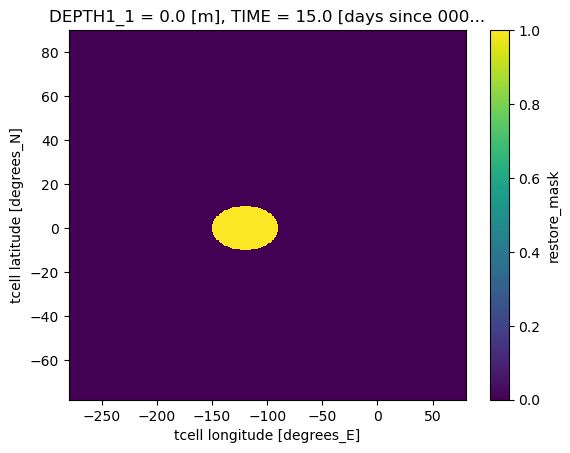

In [54]:
dataarray_masked[0,0].plot()


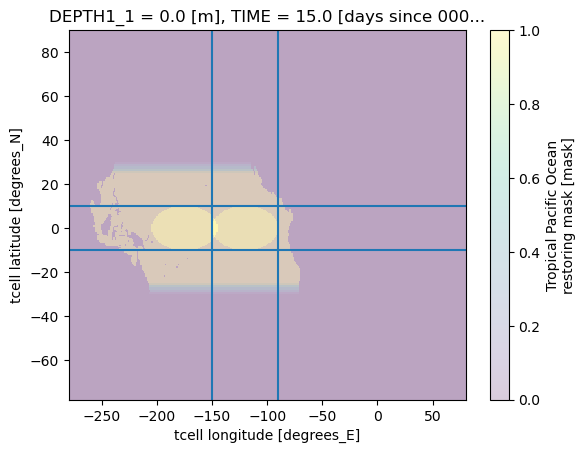

In [56]:
mask[0,0].plot(alpha = 0.2)
dataarray_masked[0,0].plot(alpha = 0.1, add_colorbar = False)
dataarray_masked2[0,0].plot(alpha = 0.1, add_colorbar = False)

plt.axhline(-10)
plt.axhline(10)
plt.axvline(-150)
plt.axvline(-90)

In [45]:
def roll_lon2(df):
    df.coords['GRID_X_T'] = (df.coords['GRID_X_T'] + 360) % 360# - 180
    df = df.sortby(df.GRID_X_T)
    return df

In [46]:
dataarray_masked = roll_lon2(dataarray_masked)

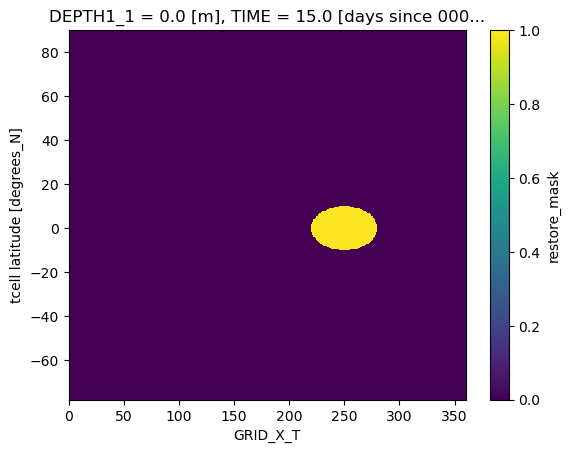

In [47]:
dataarray_masked[0,0].plot()

In [4]:
#load in ctrl dataset
ctrl_ds = xr.open_dataset("/g/data/e14/sm2435/Exps_ACCESS_initial/ctrl_sst.nc",  use_cftime=True, chunks= {"time":240})
ctrl = ctrl_ds.sst.compute()

In [5]:
def roll_lon(df):
    df.coords['xt_ocean'] = (df.coords['xt_ocean'] + 360) % 360# - 180
    df = df.sortby(df.xt_ocean)
    return df

In [6]:
ctrl = roll_lon(ctrl)

In [7]:
exp_dir = "/scratch/e14/sm2435/archive/"

In [8]:
suffix = "/history/ocn/ocean_month.nc*"

In [9]:
CP_had_ens_list = ["de419", "de420", "de421", "de422", "dd756", "de760", "de696", "de697", "de698", "de699",
                  "de861", "de862", "de863", "de864", "de865", "de881", "de882", "de883"]
CP_mod_ens_list = ["de423", "de424", "de425", "de426", "de353", "de700", "de701", "de702", "de703", "de704",
                  "de866", "de867", "de868", "de869", "de870", "de884", "de885", "de886"]
EP_had_ens_list = ["de427", "de428", "de429", "de430", "de354", "de705", "de706", "de707", "de708", "de709", 
                  "de871", "de872", "de873", "de874", "de875", "de887", "de888", "de889"]
EP_mod_ens_list = ["de431", "de432", "de433", "de434", "de355",  "de710", "de711", "de712", "de713", "de714",
                  "de876", "de877", "de878", "de879", "de880", "de890", "de891", "de892"]

In [10]:
new_time = ctrl.time[0:24]

In [82]:
CP_had_ens={}
for exp in CP_had_ens_list:
    ds = xr.open_mfdataset(exp_dir+exp+suffix, use_cftime=True, chunks= {"time":12})
    sst = ds.sst
    sst = roll_lon(sst)
    #change the time to 0000
    sst['time'] = new_time
    sst.coords['exp'] = exp
    CP_had_ens[exp] = sst

In [83]:
CP_mod_ens={}
for exp in CP_mod_ens_list:
    ds = xr.open_mfdataset(exp_dir+exp+suffix, use_cftime=True, chunks= {"time":12})
    sst = ds.sst
    sst = roll_lon(sst)
    #change the time to 0000
    sst['time'] = new_time
    sst.coords['exp'] = exp
    CP_mod_ens[exp] = sst

In [84]:
EP_had_ens={}
for exp in EP_had_ens_list:
    ds = xr.open_mfdataset(exp_dir+exp+suffix, use_cftime=True, chunks= {"time":12})
    sst = ds.sst
    sst = roll_lon(sst)
    #change the time to 0000
    sst['time'] = new_time
    sst.coords['exp'] = exp
    EP_had_ens[exp] = sst

In [85]:
EP_mod_ens={}
for exp in EP_mod_ens_list:
    ds = xr.open_mfdataset(exp_dir+exp+suffix, use_cftime=True, chunks= {"time":12})
    sst = ds.sst
    sst = roll_lon(sst)
    #change the time to 0000
    sst['time'] = new_time
    sst.coords['exp'] = exp
    EP_mod_ens[exp] = sst

In [86]:
CP_MOD = xr.concat(CP_mod_ens.values(), dim='exp')
EP_MOD = xr.concat(EP_mod_ens.values(), dim='exp')
CP_HAD = xr.concat(CP_had_ens.values(), dim='exp')
EP_HAD = xr.concat(EP_had_ens.values(), dim='exp')

In [87]:
CP_MOD_ANOM = CP_MOD.groupby("time.month") - ctrl.groupby("time.month").mean("time")
EP_MOD_ANOM = EP_MOD.groupby("time.month") - ctrl.groupby("time.month").mean("time")
CP_HAD_ANOM = CP_HAD.groupby("time.month") - ctrl.groupby("time.month").mean("time")
EP_HAD_ANOM = EP_HAD.groupby("time.month") - ctrl.groupby("time.month").mean("time")

In [88]:
def ssta(DS):
    clim = DS.groupby('time.month').mean('time')
    ssta = DS.groupby('time.month') - clim
    return ssta.drop("month")
def DMI_ctrl(DS):
    WTIO =  ssta(DS).sel(yt_ocean=slice(
         -10, 10),xt_ocean=slice(50, 70)).mean(['yt_ocean', 'xt_ocean'])
    SETIO =  ssta(DS).sel(yt_ocean=slice(
         -10, 0),xt_ocean=slice(90, 110)).mean(['yt_ocean', 'xt_ocean'])
    return (WTIO - SETIO)

def DMI_exp(DS):
    WTIO =  (DS).sel(yt_ocean=slice(
         -10, 10),xt_ocean=slice(50, 70)).mean(['yt_ocean', 'xt_ocean'])
    SETIO =  (DS).sel(yt_ocean=slice(
         -10, 0),xt_ocean=slice(90, 110)).mean(['yt_ocean', 'xt_ocean'])
    return (WTIO - SETIO)

In [89]:
def SE_exp(DS):
    SETIO =  (DS).sel(yt_ocean=slice(
         -10, 0),xt_ocean=slice(90, 110)).mean(['yt_ocean', 'xt_ocean'])
    return (SETIO)

In [90]:
def WT_exp(DS):
    WTIO =  (DS).sel(yt_ocean=slice(
         -10, 10),xt_ocean=slice(50, 70)).mean(['yt_ocean', 'xt_ocean'])
    return (WTIO)

In [91]:
def IOBM(DS):
    N4 =  (DS).sel(yt_ocean=slice(
         -20, 20),xt_ocean=slice(40,110)).mean(['yt_ocean', 'xt_ocean'])
    return N4

In [92]:
def NINO34(DS):
    N4 =  (DS).sel(yt_ocean=slice(
         -10, 10),xt_ocean=slice(190, 240)).mean(['yt_ocean', 'xt_ocean'])
    return N4

In [93]:
def NINO4(DS):
    N4 =  (DS).sel(yt_ocean=slice(
         -10, 10),xt_ocean=slice(160, 210)).mean(['yt_ocean', 'xt_ocean'])
    return N4

In [94]:
def get_IOD_members_IDX(EXP, TH, index):
    DMI = DMI_exp(EXP)
    IDX = index(EXP)
    #look between July and december
    TS = DMI.sel(time=slice("0950-06-01", "0950-12-31"))
    TS2 = IDX.where(TS.exp == TS.where(TS>=TH, drop =True).exp)
    return TS2

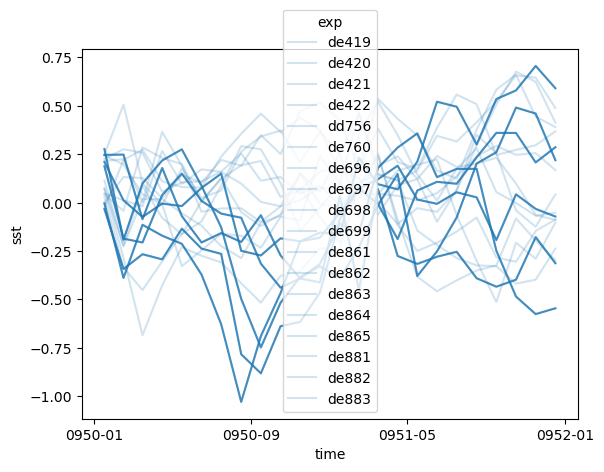

In [24]:
get_IOD_members_IDX(CP_HAD_ANOM, 0.5, SE_exp).plot(hue = "exp", c="tab:blue", alpha = 0.8)
SE_exp(CP_HAD_ANOM).plot(hue = "exp", c = "tab:blue", alpha = 0.2)

In [25]:
def plot_index(SE_exp):
    fig, axes = plt.subplots(2, 2, figsize=(12, 8), sharey=True)

    SE_exp(CP_HAD_ANOM).plot(ax=axes[0, 0], hue='exp', c='tab:blue', alpha=0.2, add_legend=False)
    get_IOD_members_IDX(CP_HAD_ANOM, 0.5, SE_exp).plot(ax=axes[0, 0], hue = "exp", c="tab:blue", alpha = 0.8, add_legend=False)
    SE_exp(CP_HAD_ANOM).median("exp").plot(ax=axes[0, 0], c="k", ls = '--', lw = 0.5)
    axes[0, 0].set_title('CP El Nino HadISST')

    SE_exp(EP_HAD_ANOM).plot(ax=axes[0, 1], hue='exp', c='tab:blue', alpha=0.2, add_legend=False)
    get_IOD_members_IDX(EP_HAD_ANOM, 0.5, SE_exp).plot(ax=axes[0, 1], hue = "exp", c="tab:blue", alpha = 0.8, add_legend=False)

    SE_exp(EP_HAD_ANOM).median("exp").plot(ax=axes[0, 1],  c="k", ls = '--', lw = 0.5)
    axes[0, 1].set_title('EP El Nino HadISST')

    SE_exp(CP_MOD_ANOM).plot(ax=axes[1, 0], hue='exp', c='tab:blue', alpha=0.2, add_legend=False)
    get_IOD_members_IDX(CP_MOD_ANOM, 0.5, SE_exp).plot(ax=axes[1, 0], hue = "exp", c="tab:blue", alpha = 0.8, add_legend=False)    
    SE_exp(CP_MOD_ANOM).median("exp").plot(ax=axes[1, 0], c="k", ls = '--', lw = 0.5)
    axes[1, 0].set_title('CP El Nino ACCESS-CM2')

    SE_exp(EP_MOD_ANOM).plot(ax=axes[1, 1], hue='exp', c='tab:blue', alpha=0.2, add_legend=False)
    get_IOD_members_IDX(EP_MOD_ANOM, 0.5, SE_exp).plot(ax=axes[1, 1], hue = "exp", c="tab:blue", alpha = 0.8, add_legend=False)    
    SE_exp(EP_MOD_ANOM).median("exp").plot(ax=axes[1, 1],  c="k", ls = '--', lw = 0.5, label="Median")
    axes[1, 1].set_title('EP El Nino ACCESS-CM2')

    # Add legend
    custom_legend = [
        plt.Line2D([0], [0], color='tab:blue', lw=1, alpha=0.2),
        plt.Line2D([0], [0], color='tab:blue', lw=1, alpha=1),
        plt.Line2D([0], [0], color='k', lw=0.5, ls = "--")
    ]

    fig.legend(custom_legend, ["Non-IOD member", "IOD member", "Median"])
    #fig.legend()

    plt.tight_layout()
    plt.show()
    return fig


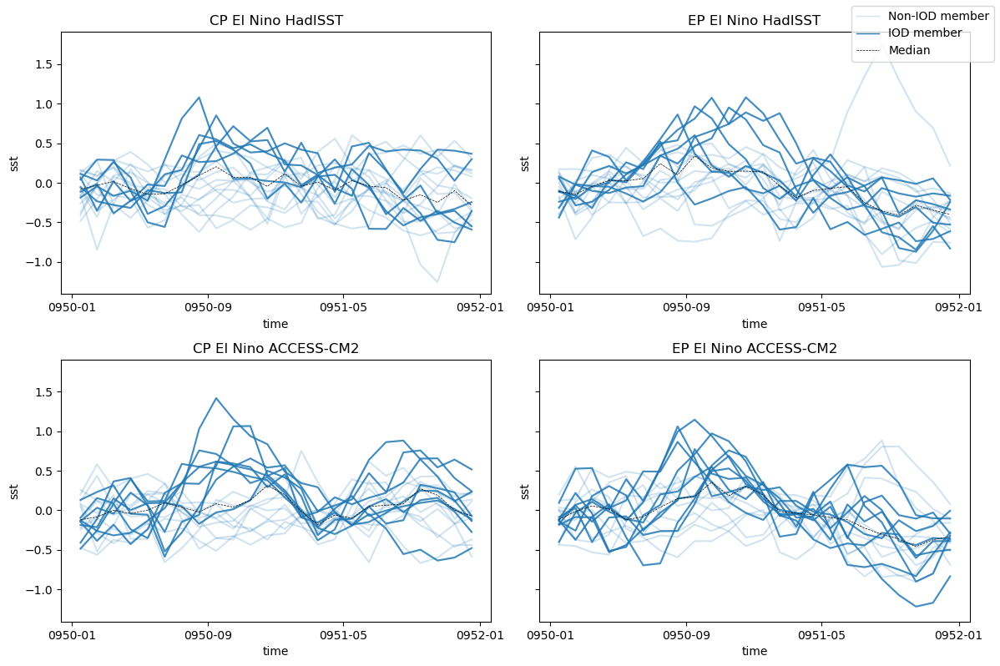

In [26]:
p = plot_index(DMI_exp)

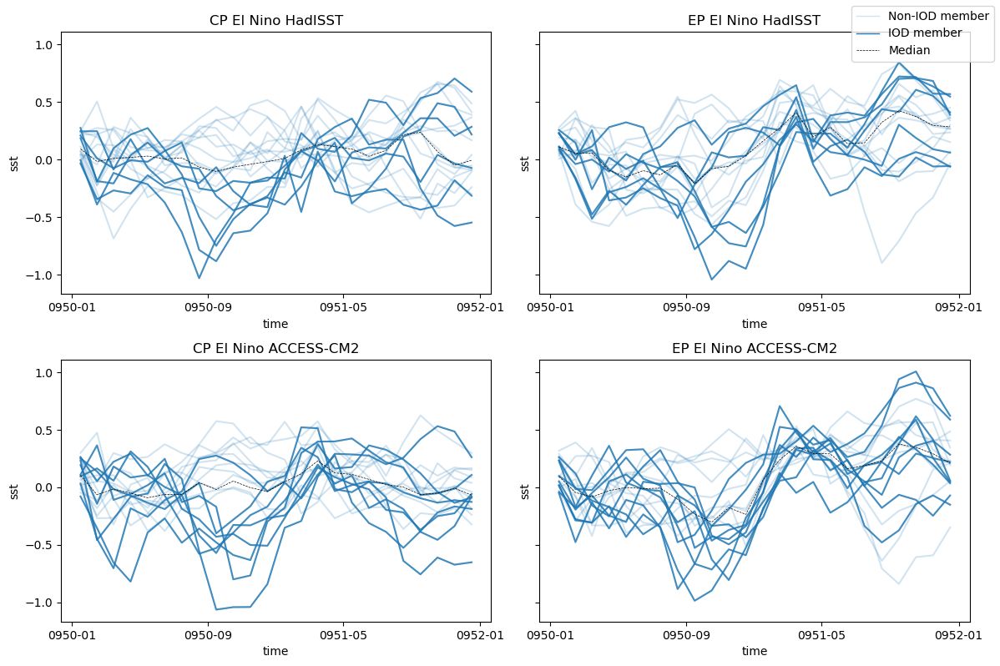

In [27]:
p = plot_index(SE_exp)

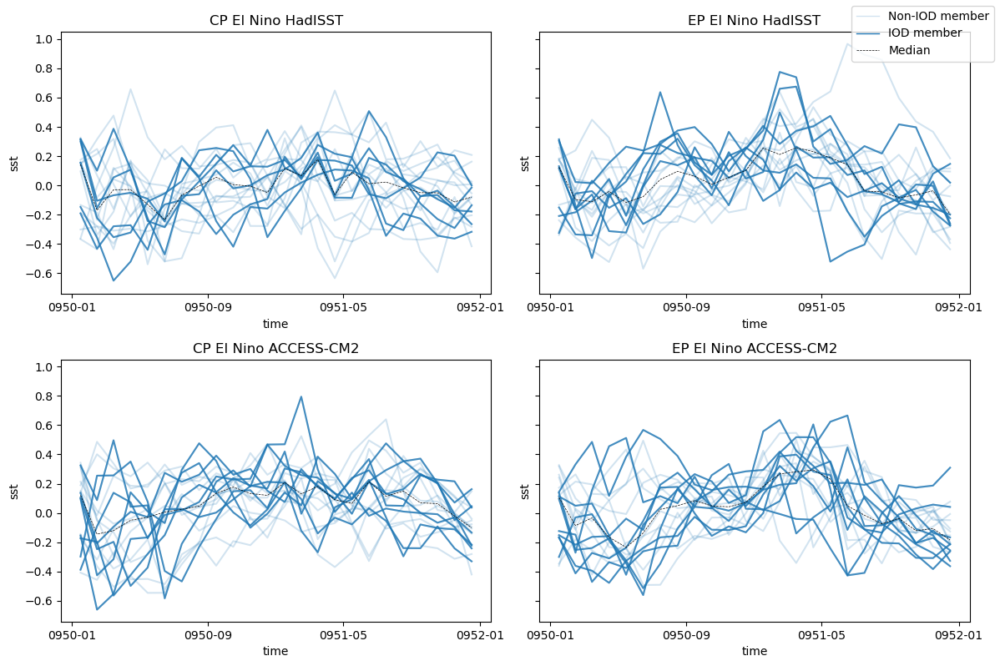

In [28]:
p = plot_index(WT_exp)

In [96]:
###Look at spatial pattern
from scipy.stats import ttest_1samp

In [97]:
RES = ttest_1samp(CP_HAD_ANOM, 0, axis = 0)

In [28]:
RES1 = ttest_1samp(EP_HAD_ANOM, 0, axis = 0)

In [29]:
RES2 = ttest_1samp(CP_MOD_ANOM, 0, axis = 0)

In [30]:
RES3 = ttest_1samp(EP_MOD_ANOM, 0, axis = 0)

In [44]:
RES1[1].shape

(24, 300, 360)

In [106]:
RES_p = xr.DataArray(RES[1], dims = {"time": EP_HAD_ANOM.time, "xt_ocean": EP_HAD_ANOM.xt_ocean, "yt_ocean": EP_HAD_ANOM.yt_ocean})

In [104]:
RES_p

<xarray.DataArray (time: 24, xt_ocean: 300, yt_ocean: 360)>
array([[[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        ...,
        [0.1836129 , 0.24968021, 0.31743337, ..., 0.73956499,
         0.53242094, 0.26737374],
        [0.72657206, 0.82983004, 0.68678391, ..., 0.34010136,
         0.28753488, 0.27512684],
        [0.08408604, 0.31683708, 0.69652044, ..., 0.12478454,
         0.08007709, 0.05434269]],

       [[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
...
        [0.28489788, 0.29385744, 0.31005819, ..., 0.2121451 ,
         0.24713822, 0.27208881],
        [0.07298627, 0.08078393, 0.0879688 , ..., 0.04282142,
         0.0465215 , 0.05887389],
        [0.01752246, 0.02095065, 0.02405092, ..., 0.01504499,
         0.01212912, 0.01343121]],

       [[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        ...,
        [0.21456895, 0.22973789, 0.2559934 , ..., 0.11923866,
         0.1575945 , 0.19523935],
        [0.0535038 , 0.06465563, 0.07406695, ..., 0.02398966,
         0.02973791, 0.041467  ],
        [0.01352872, 0.01745529, 0.02040391, ..., 0.00902522,
         0.00836634, 0.01022278]]])
Dimensions without coordinates: time, xt_ocean, yt_ocean

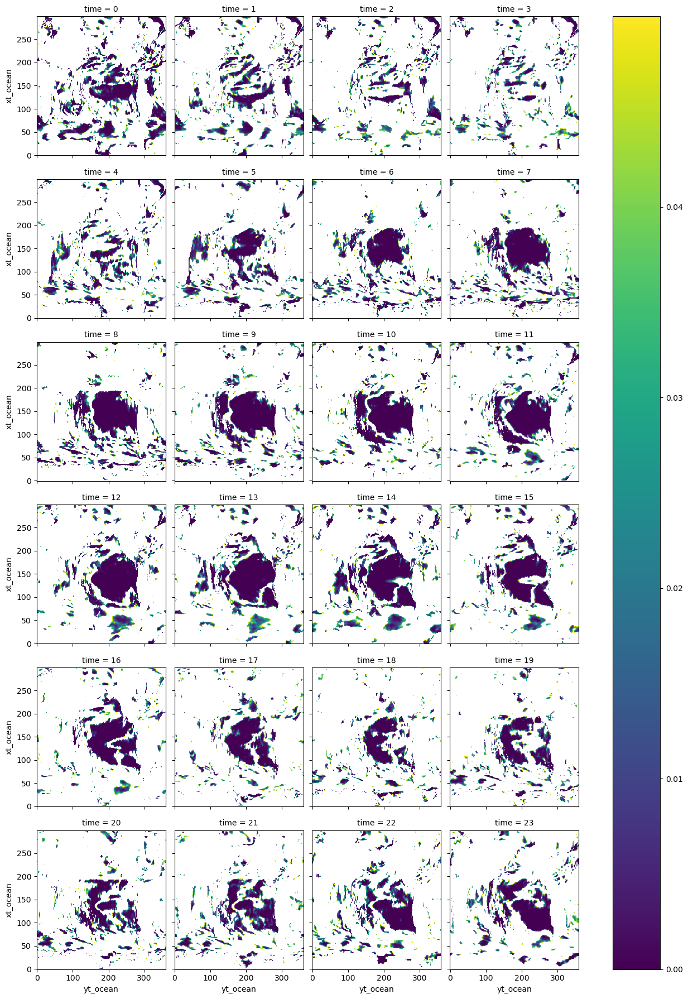

In [103]:
RES_p.where(RES_p <0.05, np.nan).plot(col = "time", col_wrap = 4)

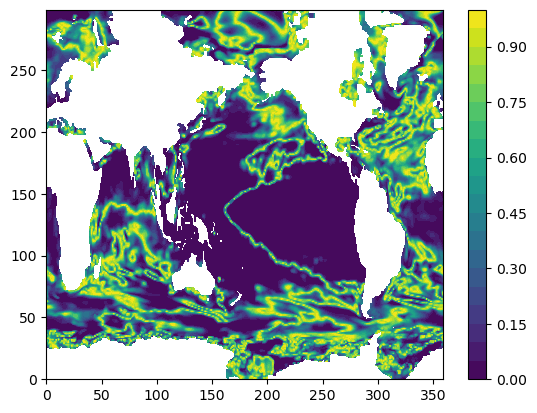

In [45]:
plt.contourf(RES1[1][9], levels = 20)
plt.colorbar()

In [11]:
def roll_lon_u(df):
    df.coords['xu_ocean'] = (df.coords['xu_ocean'] + 360) % 360# - 180
    df = df.sortby(df.xu_ocean)
    return df

In [12]:
#load in Winds

In [13]:
CP_had_U={}
for exp in CP_had_ens_list:
    ds = xr.open_mfdataset(exp_dir+exp+suffix, use_cftime=True, chunks= {"time":12})
    tauu = ds.tau_x
    tauu = roll_lon_u(tauu)
    #change the time to 0000
    tauu['time'] = new_time
    tauu.coords['exp'] = exp
    CP_had_U[exp] = tauu

In [14]:
CP_mod_U={}
for exp in CP_mod_ens_list:
    ds = xr.open_mfdataset(exp_dir+exp+suffix, use_cftime=True, chunks= {"time":12})
    tauu = ds.tau_x
    tauu = roll_lon_u(tauu)
    #change the time to 0000
    tauu['time'] = new_time
    tauu.coords['exp'] = exp
    CP_mod_U[exp] = tauu

In [15]:
EP_had_U={}
for exp in EP_had_ens_list:
    ds = xr.open_mfdataset(exp_dir+exp+suffix, use_cftime=True, chunks= {"time":12})
    tauu = ds.tau_x
    tauu = roll_lon_u(tauu)
    #change the time to 0000
    tauu['time'] = new_time
    tauu.coords['exp'] = exp
    EP_had_U[exp] = tauu

In [16]:
EP_mod_U={}
for exp in EP_mod_ens_list:
    ds = xr.open_mfdataset(exp_dir+exp+suffix, use_cftime=True, chunks= {"time":12})
    tauu = ds.tau_x
    tauu = roll_lon_u(tauu)
    #change the time to 0000
    tauu['time'] = new_time
    tauu.coords['exp'] = exp
    EP_mod_U[exp] = tauu

In [17]:
CP_MOD_u = xr.concat(CP_mod_U.values(), dim='exp')
EP_MOD_u = xr.concat(EP_mod_U.values(), dim='exp')
CP_HAD_u = xr.concat(CP_had_U.values(), dim='exp')
EP_HAD_u = xr.concat(EP_had_U.values(), dim='exp')

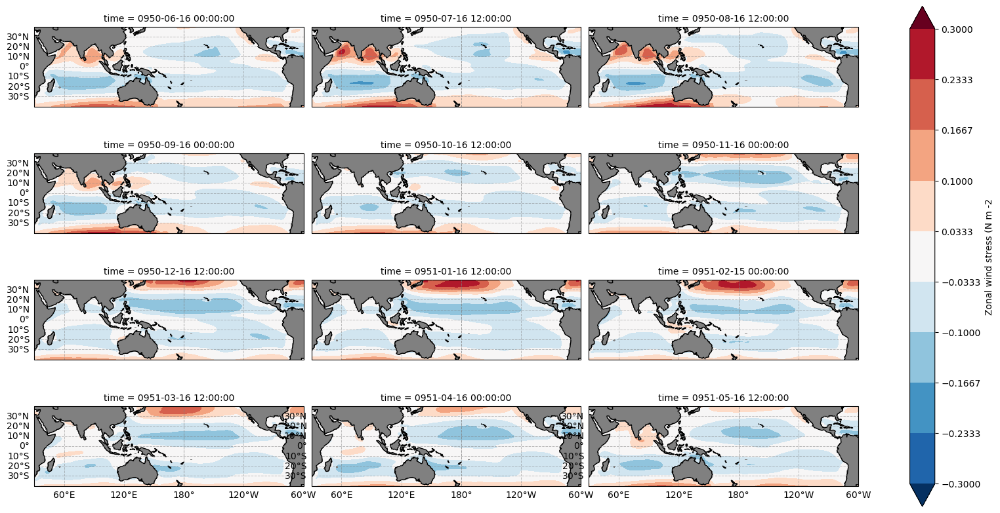

In [22]:
lat_limits = (-40, 40)
lon_limits = (-150, 120) 
fg = CP_MOD_u.mean("exp")[5:17].plot.contourf(col="time", col_wrap = 3, transform=ccrs.PlateCarree(),
                subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180), "xlim": lon_limits, "ylim": lat_limits},
                          figsize=(16,8), vmin = -0.3, levels =10, extend = 'both',  cmap = 'RdBu_r',
                            cbar_kwargs=dict(label='Zonal wind stress (N m -2'))
for i, ax in enumerate(fg.axs.flat):
    ax.coastlines()
    ax.set_facecolor('grey')
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')

    if i in [0,1,2,3,4,5,6,7,8]:
        gl.bottom_labels = False
    if i in [1,2,4,5,7,8]:
        gl.left_labels = False
    gl.top_labels = False
    gl.right_labels = False  

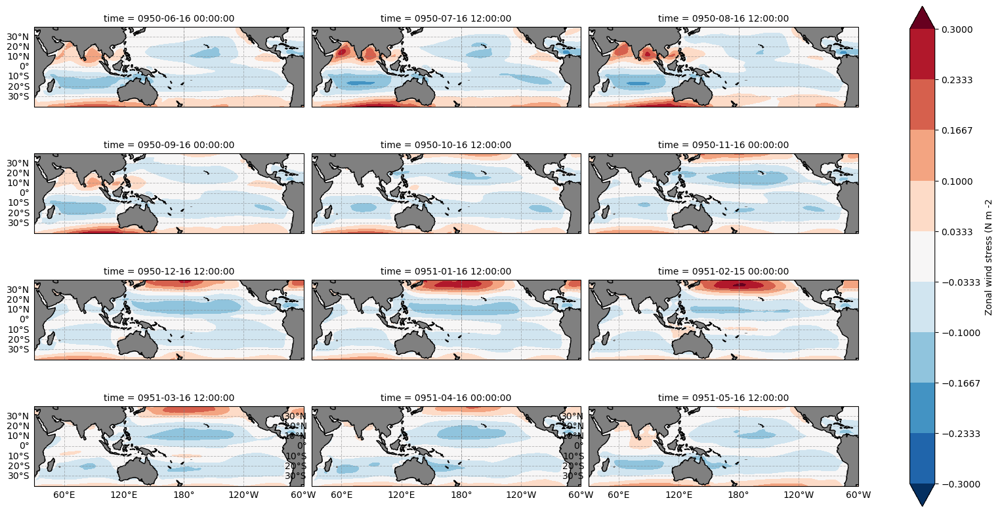

In [23]:
lat_limits = (-40, 40)
lon_limits = (-150, 120) 
fg = EP_MOD_u.mean("exp")[5:17].plot.contourf(col="time", col_wrap = 3, transform=ccrs.PlateCarree(),
                subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180), "xlim": lon_limits, "ylim": lat_limits},
                          figsize=(16,8), vmin = -0.3, levels =10, extend = 'both',  cmap = 'RdBu_r',
                            cbar_kwargs=dict(label='Zonal wind stress (N m -2'))
for i, ax in enumerate(fg.axs.flat):
    ax.coastlines()
    ax.set_facecolor('grey')
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')

    if i in [0,1,2,3,4,5,6,7,8]:
        gl.bottom_labels = False
    if i in [1,2,4,5,7,8]:
        gl.left_labels = False
    gl.top_labels = False
    gl.right_labels = False  

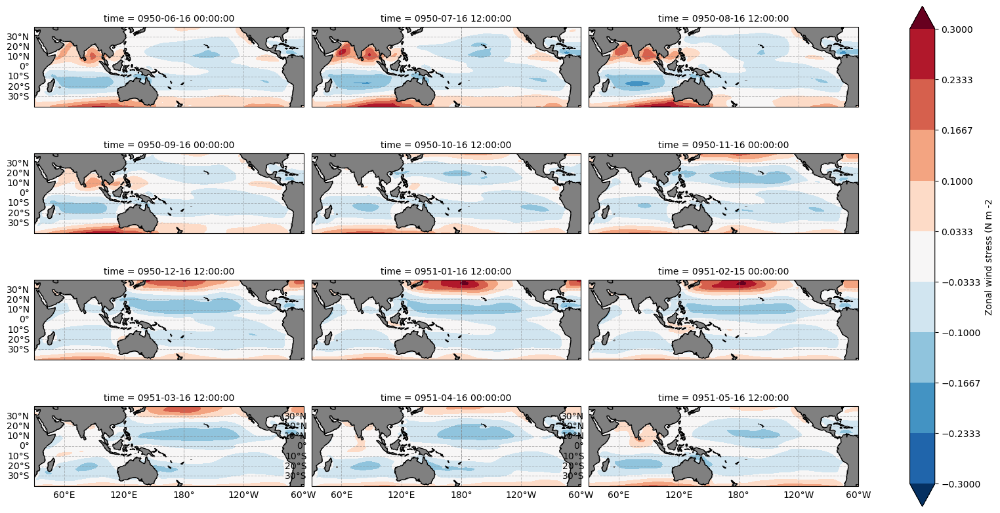

In [24]:
lat_limits = (-40, 40)
lon_limits = (-150, 120) 
fg = CP_HAD_u.mean("exp")[5:17].plot.contourf(col="time", col_wrap = 3, transform=ccrs.PlateCarree(),
                subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180), "xlim": lon_limits, "ylim": lat_limits},
                          figsize=(16,8), vmin = -0.3, levels =10, extend = 'both',  cmap = 'RdBu_r',
                            cbar_kwargs=dict(label='Zonal wind stress (N m -2'))
for i, ax in enumerate(fg.axs.flat):
    ax.coastlines()
    ax.set_facecolor('grey')
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')

    if i in [0,1,2,3,4,5,6,7,8]:
        gl.bottom_labels = False
    if i in [1,2,4,5,7,8]:
        gl.left_labels = False
    gl.top_labels = False
    gl.right_labels = False  

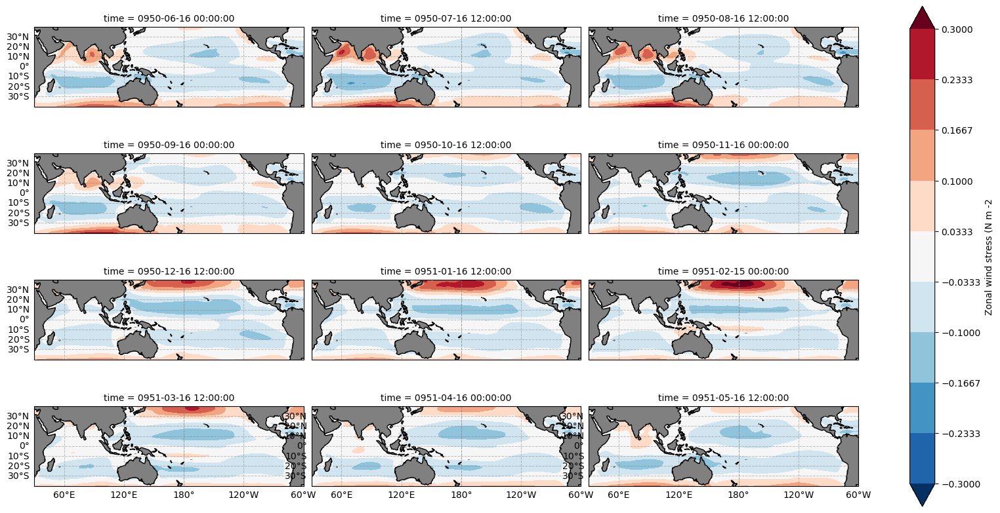

In [25]:
lat_limits = (-40, 40)
lon_limits = (-150, 120) 
fg = EP_HAD_u.mean("exp")[5:17].plot.contourf(col="time", col_wrap = 3, transform=ccrs.PlateCarree(),
                subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180), "xlim": lon_limits, "ylim": lat_limits},
                          figsize=(16,8), vmin = -0.3, levels =10, extend = 'both',  cmap = 'RdBu_r',
                            cbar_kwargs=dict(label='Zonal wind stress (N m -2'))
for i, ax in enumerate(fg.axs.flat):
    ax.coastlines()
    ax.set_facecolor('grey')
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')

    if i in [0,1,2,3,4,5,6,7,8]:
        gl.bottom_labels = False
    if i in [1,2,4,5,7,8]:
        gl.left_labels = False
    gl.top_labels = False
    gl.right_labels = False  

In [65]:
#load in ctrl u winds

In [26]:
ctrl_u = xr.open_dataset("/g/data/e14/sm2435/Exps_ACCESS_initial/ctrl_uwnd.nc", use_cftime=True, chunks = {"time":12})

In [27]:
ctrl_u = roll_lon_u(ctrl_u.tauu)

In [28]:
ctrl_u =ctrl_u.compute()

In [29]:
CP_MOD_ANOMu = CP_MOD_u.groupby("time.month") - ctrl_u.groupby("time.month").mean("time")
EP_MOD_ANOMu = EP_MOD_u.groupby("time.month") - ctrl_u.groupby("time.month").mean("time")
CP_HAD_ANOMu = CP_HAD_u.groupby("time.month") - ctrl_u.groupby("time.month").mean("time")
EP_HAD_ANOMu = EP_HAD_u.groupby("time.month") - ctrl_u.groupby("time.month").mean("time")

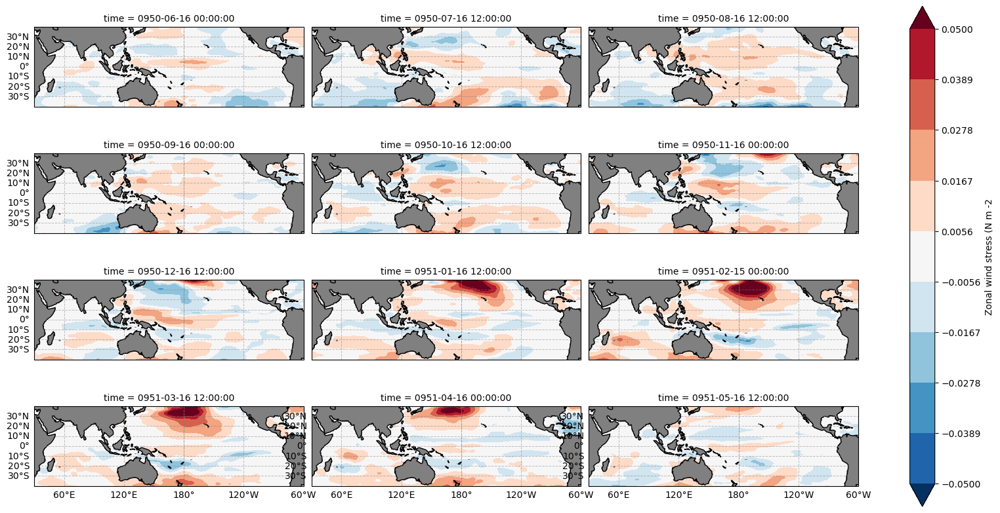

In [33]:
lat_limits = (-40, 40)
lon_limits = (-150, 120) 
fg = CP_MOD_ANOMu.mean("exp")[5:17].plot.contourf(col="time", col_wrap = 3, transform=ccrs.PlateCarree(),
                subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180), "xlim": lon_limits, "ylim": lat_limits},
                          figsize=(16,8), vmin = -0.05, levels =10, extend = 'both',  cmap = 'RdBu_r',
                            cbar_kwargs=dict(label='Zonal wind stress (N m -2'))
for i, ax in enumerate(fg.axs.flat):
    ax.coastlines()
    ax.set_facecolor('grey')
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')

    if i in [0,1,2,3,4,5,6,7,8]:
        gl.bottom_labels = False
    if i in [1,2,4,5,7,8]:
        gl.left_labels = False
    gl.top_labels = False
    gl.right_labels = False  

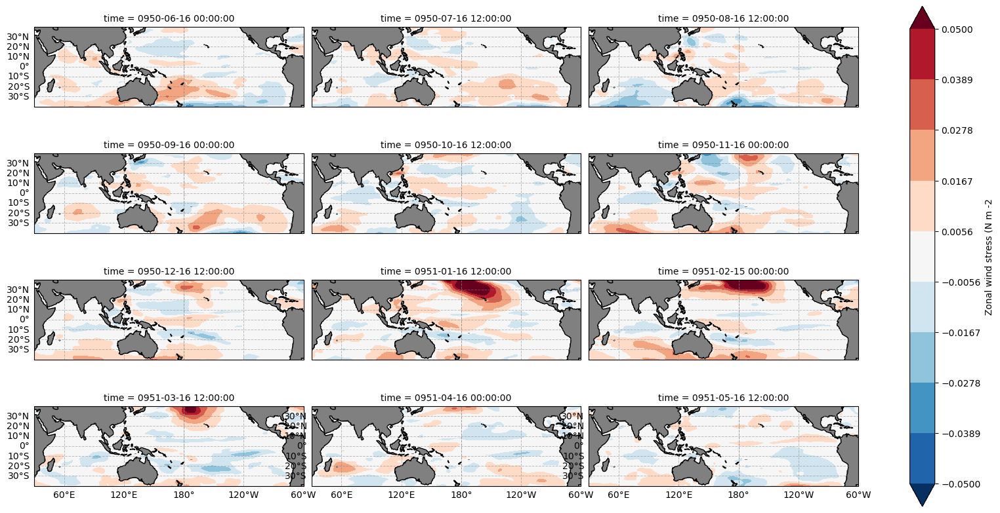

In [37]:
lat_limits = (-40, 40)
lon_limits = (-150, 120) 
fg = CP_HAD_ANOMu.mean("exp")[5:17].plot.contourf(col="time", col_wrap = 3, transform=ccrs.PlateCarree(),
                subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180), "xlim": lon_limits, "ylim": lat_limits},
                          figsize=(16,8), vmin = -0.05, levels =10, extend = 'both',  cmap = 'RdBu_r',
                            cbar_kwargs=dict(label='Zonal wind stress (N m -2'))
for i, ax in enumerate(fg.axs.flat):
    ax.coastlines()
    ax.set_facecolor('grey')
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')

    if i in [0,1,2,3,4,5,6,7,8]:
        gl.bottom_labels = False
    if i in [1,2,4,5,7,8]:
        gl.left_labels = False
    gl.top_labels = False
    gl.right_labels = False  

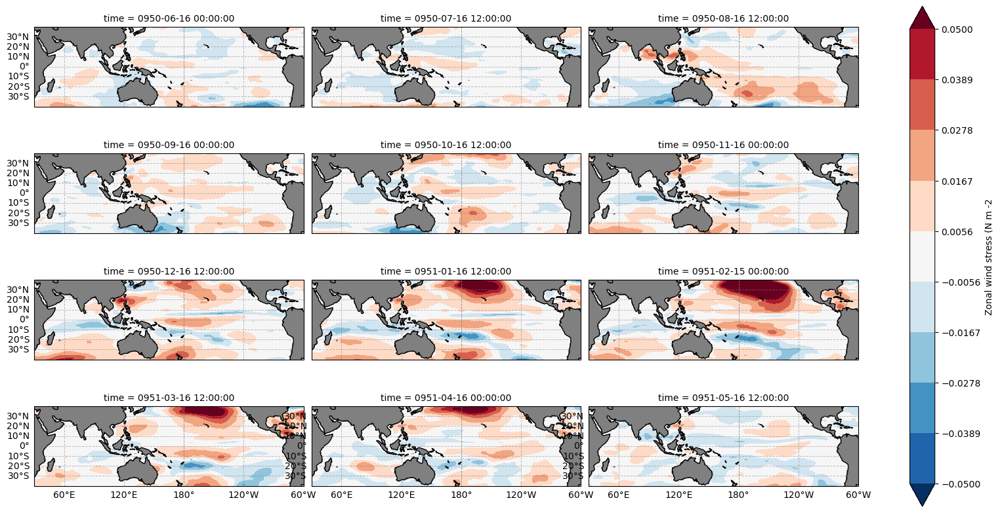

In [38]:
lat_limits = (-40, 40)
lon_limits = (-150, 120) 
fg = EP_MOD_ANOMu.mean("exp")[5:17].plot.contourf(col="time", col_wrap = 3, transform=ccrs.PlateCarree(),
                subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180), "xlim": lon_limits, "ylim": lat_limits},
                          figsize=(16,8), vmin = -0.05, levels =10, extend = 'both',  cmap = 'RdBu_r',
                            cbar_kwargs=dict(label='Zonal wind stress (N m -2'))
for i, ax in enumerate(fg.axs.flat):
    ax.coastlines()
    ax.set_facecolor('grey')
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')

    if i in [0,1,2,3,4,5,6,7,8]:
        gl.bottom_labels = False
    if i in [1,2,4,5,7,8]:
        gl.left_labels = False
    gl.top_labels = False
    gl.right_labels = False  

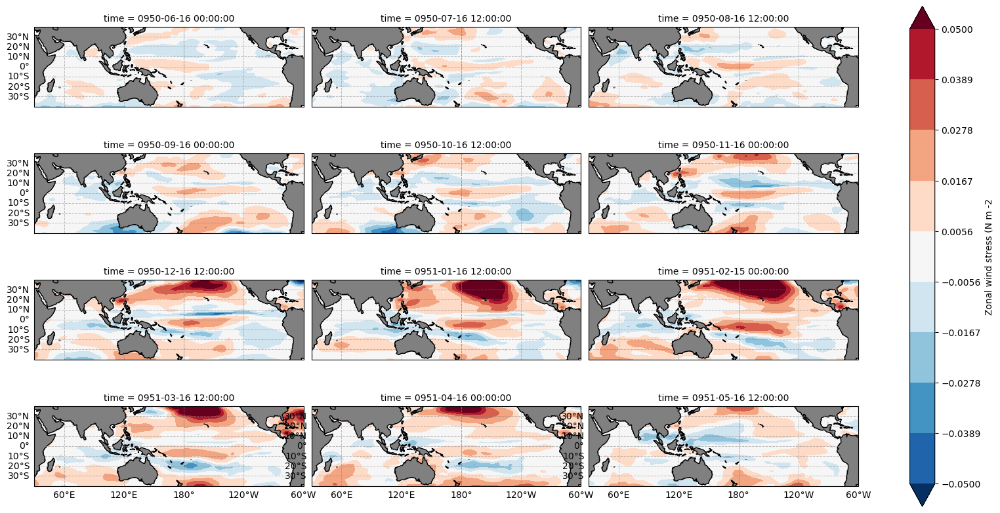

In [39]:
lat_limits = (-40, 40)
lon_limits = (-150, 120) 
fg = EP_HAD_ANOMu.mean("exp")[5:17].plot.contourf(col="time", col_wrap = 3, transform=ccrs.PlateCarree(),
                subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180), "xlim": lon_limits, "ylim": lat_limits},
                          figsize=(16,8), vmin = -0.05, levels =10, extend = 'both',  cmap = 'RdBu_r',
                            cbar_kwargs=dict(label='Zonal wind stress (N m -2'))
for i, ax in enumerate(fg.axs.flat):
    ax.coastlines()
    ax.set_facecolor('grey')
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')

    if i in [0,1,2,3,4,5,6,7,8]:
        gl.bottom_labels = False
    if i in [1,2,4,5,7,8]:
        gl.left_labels = False
    gl.top_labels = False
    gl.right_labels = False  

In [47]:
def ssta(DS):
    clim = DS.groupby('time.month').mean('time')
    ssta = DS.groupby('time.month') - clim
    return ssta.drop("month")
def DMI_ctrlu(DS):
    WTIO =  ssta(DS).sel(yu_ocean=slice(
         -10, 10),xu_ocean=slice(50, 70)).mean(['yu_ocean', 'xu_ocean'])
    SETIO =  ssta(DS).sel(yu_ocean=slice(
         -10, 0),xu_ocean=slice(90, 110)).mean(['yu_ocean', 'xu_ocean'])
    return (WTIO - SETIO)

def DMI_expu(DS):
    WTIO =  (DS).sel(yu_ocean=slice(
         -10, 10),xu_ocean=slice(50, 70)).mean(['yu_ocean', 'xu_ocean'])
    SETIO =  (DS).sel(yu_ocean=slice(
         -10, 0),xu_ocean=slice(90, 110)).mean(['yu_ocean', 'xu_ocean'])
    return (WTIO - SETIO)

In [48]:
def SE_expu(DS):
    SETIO =  (DS).sel(yu_ocean=slice(
         -10, 0),xu_ocean=slice(90, 110)).mean(['yu_ocean', 'xu_ocean'])
    return (SETIO)

In [49]:
def WT_expu(DS):
    WTIO =  (DS).sel(yu_ocean=slice(
         -10, 10),xu_ocean=slice(50, 70)).mean(['yu_ocean', 'xu_ocean'])
    return (WTIO)

In [50]:
def plot_index(SE_exp):
    fig, axes = plt.subplots(2, 2, figsize=(12, 8), sharey=True)

    SE_exp(CP_HAD_ANOMu).plot(ax=axes[0, 0], hue='exp', c='tab:blue', alpha=0.2, add_legend=False)
    SE_exp(CP_HAD_ANOMu).median("exp").plot(ax=axes[0, 0], c="k", ls = '--', lw = 0.5)
    axes[0, 0].set_title('CP El Nino HadISST')

    SE_exp(EP_HAD_ANOMu).plot(ax=axes[0, 1], hue='exp', c='tab:blue', alpha=0.2, add_legend=False)

    SE_exp(EP_HAD_ANOMu).median("exp").plot(ax=axes[0, 1],  c="k", ls = '--', lw = 0.5)
    axes[0, 1].set_title('EP El Nino HadISST')

    SE_exp(CP_MOD_ANOMu).plot(ax=axes[1, 0], hue='exp', c='tab:blue', alpha=0.2, add_legend=False)
    SE_exp(CP_MOD_ANOMu).median("exp").plot(ax=axes[1, 0], c="k", ls = '--', lw = 0.5)
    axes[1, 0].set_title('CP El Nino ACCESS-CM2')

    SE_exp(EP_MOD_ANOMu).plot(ax=axes[1, 1], hue='exp', c='tab:blue', alpha=0.2, add_legend=False)
    SE_exp(EP_MOD_ANOMu).median("exp").plot(ax=axes[1, 1],  c="k", ls = '--', lw = 0.5, label="Median")
    axes[1, 1].set_title('EP El Nino ACCESS-CM2')

    # Add legend
    custom_legend = [
        plt.Line2D([0], [0], color='tab:blue', lw=1, alpha=0.2),
        plt.Line2D([0], [0], color='k', lw=0.5, ls = "--")
    ]

    fig.legend(custom_legend, ["member",  "Median"])
    #fig.legend()

    plt.tight_layout()
    plt.show()
    return fig


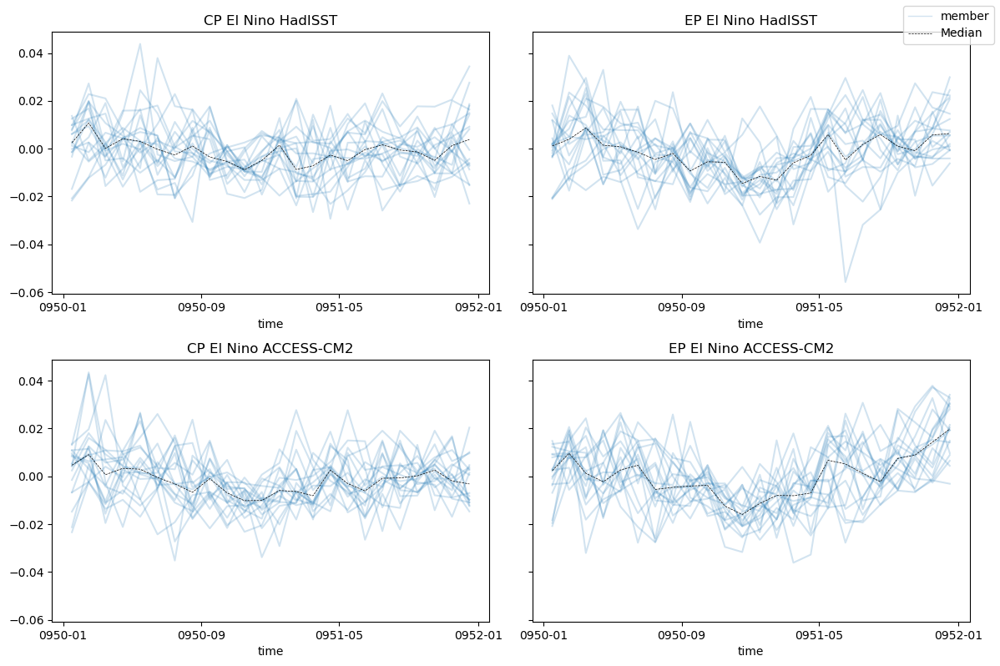

In [61]:
p = plot_index(SE_expu)

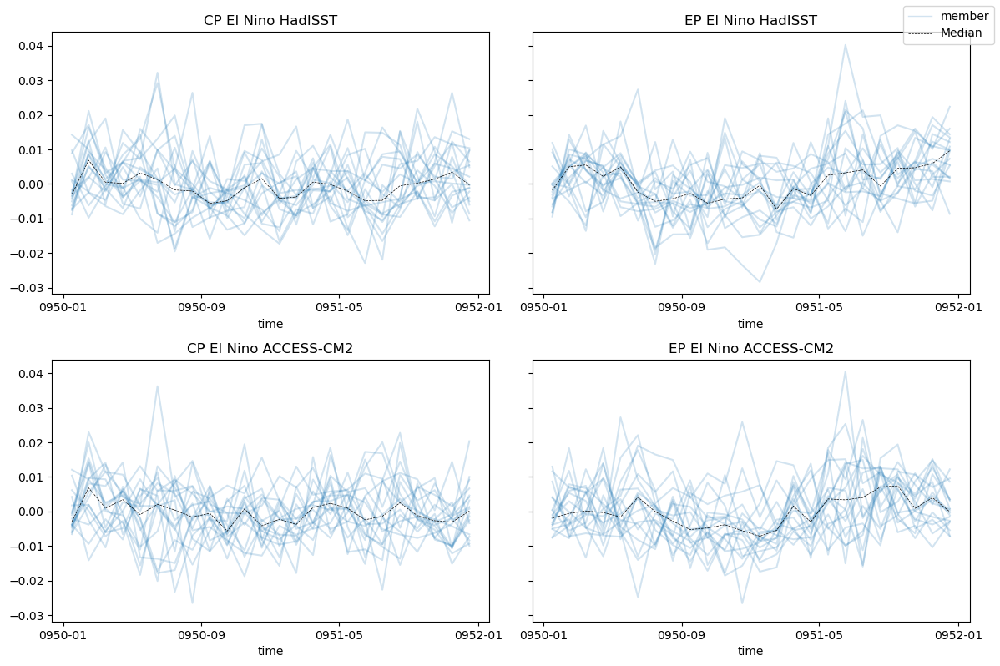

In [62]:
p = plot_index(WT_expu)

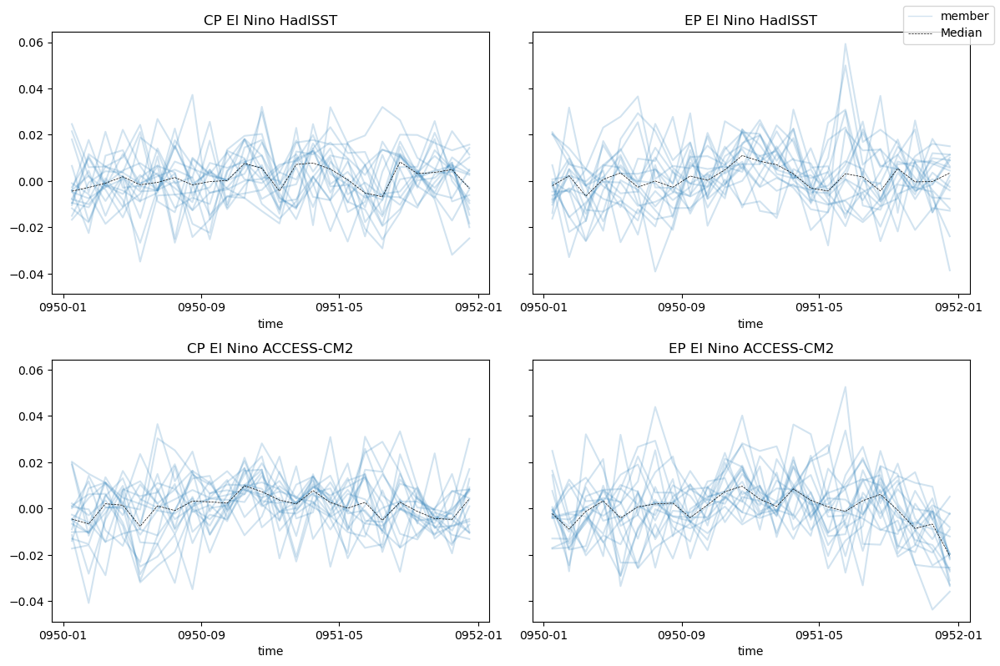

In [63]:
p = plot_index(DMI_expu)

In [64]:
def plot_index_abs(SE_exp):
    fig, axes = plt.subplots(2, 2, figsize=(12, 8), sharey=True)

    SE_exp(CP_HAD_u).plot(ax=axes[0, 0], hue='exp', c='tab:blue', alpha=0.2, add_legend=False)
    SE_exp(CP_HAD_u).median("exp").plot(ax=axes[0, 0], c="k", ls = '--', lw = 0.5)
    axes[0, 0].set_title('CP El Nino HadISST')

    SE_exp(EP_HAD_u).plot(ax=axes[0, 1], hue='exp', c='tab:blue', alpha=0.2, add_legend=False)

    SE_exp(EP_HAD_u).median("exp").plot(ax=axes[0, 1],  c="k", ls = '--', lw = 0.5)
    axes[0, 1].set_title('EP El Nino HadISST')

    SE_exp(CP_MOD_u).plot(ax=axes[1, 0], hue='exp', c='tab:blue', alpha=0.2, add_legend=False)
    SE_exp(CP_MOD_u).median("exp").plot(ax=axes[1, 0], c="k", ls = '--', lw = 0.5)
    axes[1, 0].set_title('CP El Nino ACCESS-CM2')

    SE_exp(EP_MOD_u).plot(ax=axes[1, 1], hue='exp', c='tab:blue', alpha=0.2, add_legend=False)
    SE_exp(EP_MOD_u).median("exp").plot(ax=axes[1, 1],  c="k", ls = '--', lw = 0.5, label="Median")
    axes[1, 1].set_title('EP El Nino ACCESS-CM2')

    # Add legend
    custom_legend = [
        plt.Line2D([0], [0], color='tab:blue', lw=1, alpha=0.2),
        plt.Line2D([0], [0], color='k', lw=0.5, ls = "--")
    ]

    fig.legend(custom_legend, ["member",  "Median"])
    #fig.legend()

    plt.tight_layout()
    plt.show()
    return fig


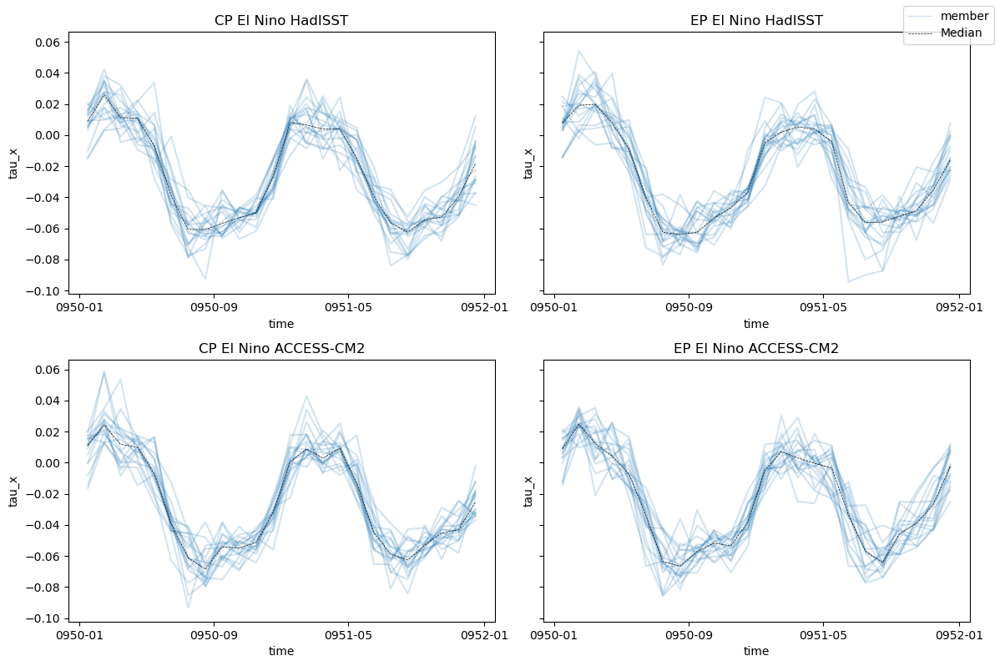

In [66]:
p = plot_index_abs(SE_expu)

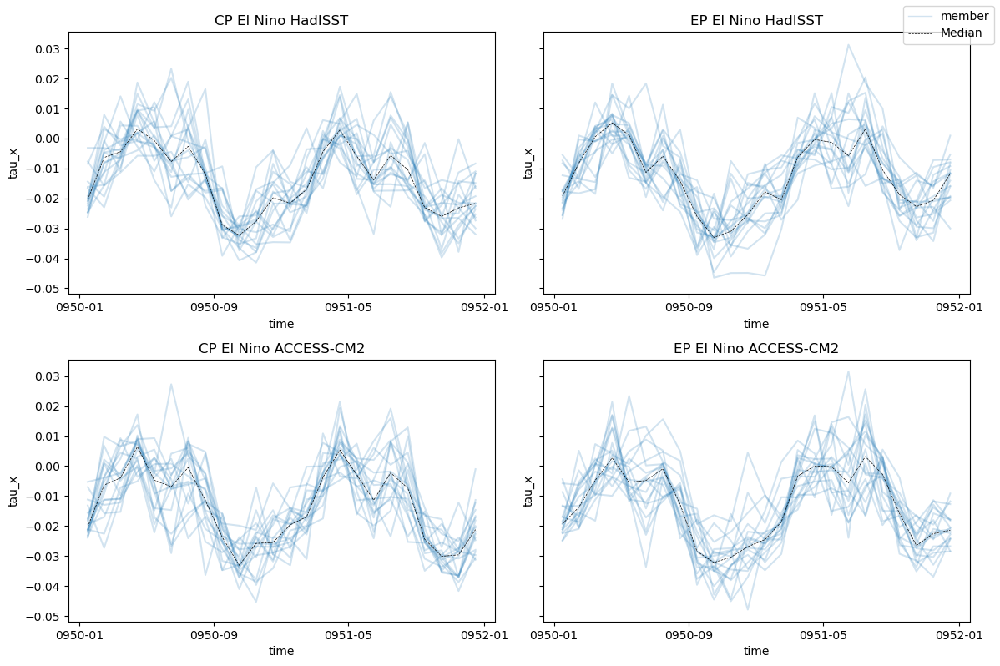

In [67]:
p = plot_index_abs(WT_expu)

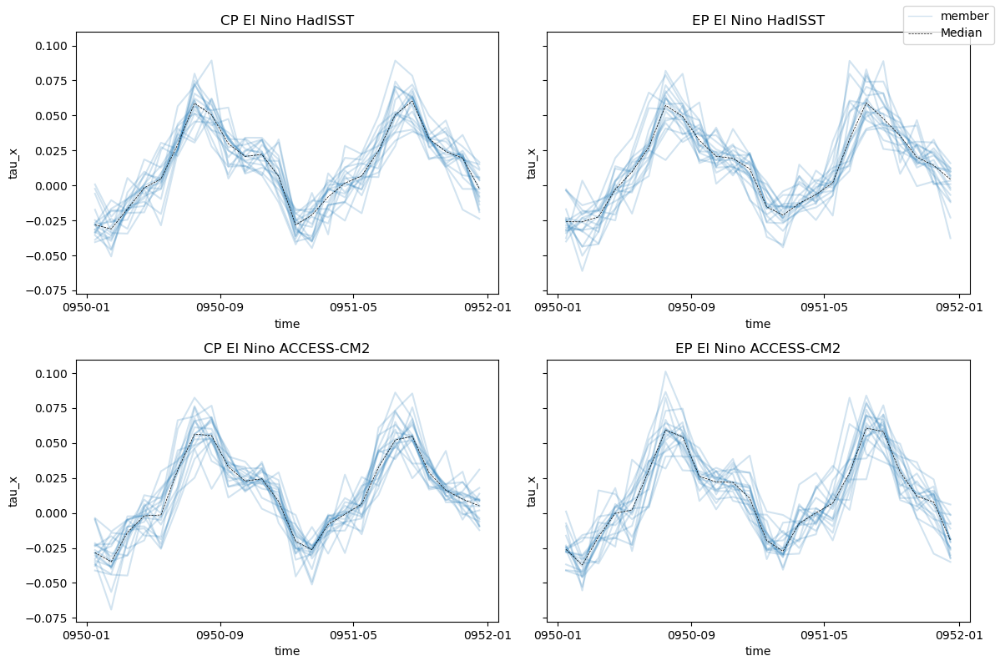

In [68]:
p = plot_index_abs(DMI_expu)

In [81]:
def get_IOD_members_IDXu(sst, u, TH, index):
    DMI = DMI_exp(sst)
    IDX = index(u)
    #look between July and december
    TS = DMI.sel(time=slice("0950-06-01", "0950-12-31"))
    TS2 = IDX.where(TS.exp == TS.where(TS>=TH, drop =True).exp)
    return TS2

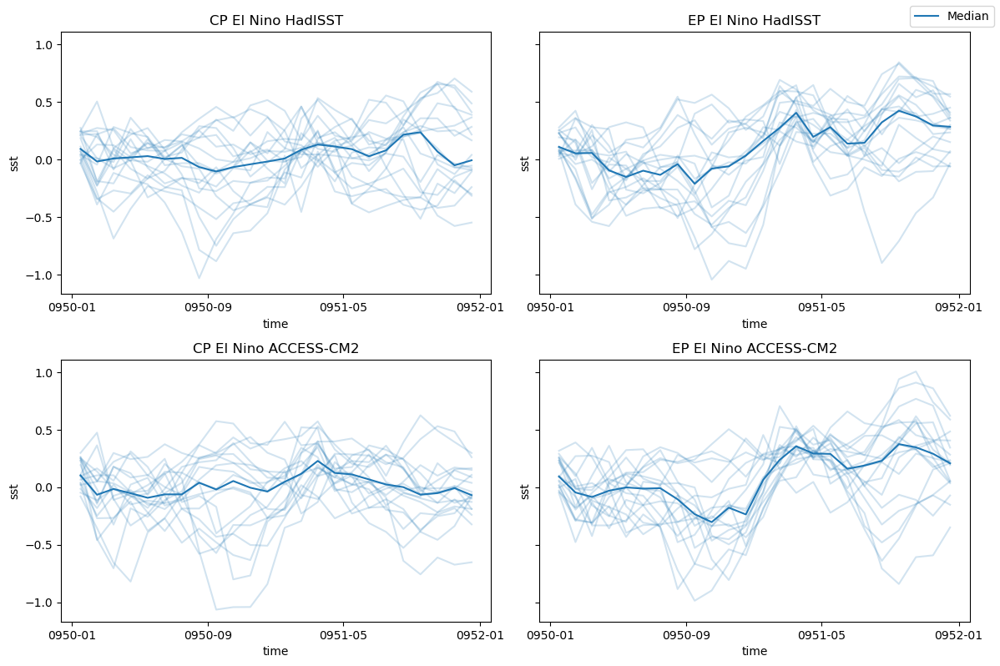

In [41]:
fig, axes = plt.subplots(2, 2, figsize=(12, 8), sharey=True)

SE_exp(CP_HAD_ANOM).plot(ax=axes[0, 0], hue='exp', c='tab:blue', alpha=0.2, add_legend=False)
SE_exp(CP_HAD_ANOM).median("exp").plot(ax=axes[0, 0], c="tab:blue")
axes[0, 0].set_title('CP El Nino HadISST')

SE_exp(EP_HAD_ANOM).plot(ax=axes[0, 1], hue='exp', c='tab:blue', alpha=0.2, add_legend=False)
SE_exp(EP_HAD_ANOM).median("exp").plot(ax=axes[0, 1], c="tab:blue")
axes[0, 1].set_title('EP El Nino HadISST')

SE_exp(CP_MOD_ANOM).plot(ax=axes[1, 0], hue='exp', c='tab:blue', alpha=0.2, add_legend=False)
SE_exp(CP_MOD_ANOM).median("exp").plot(ax=axes[1, 0], c="tab:blue")
axes[1, 0].set_title('CP El Nino ACCESS-CM2')

SE_exp(EP_MOD_ANOM).plot(ax=axes[1, 1], hue='exp', c='tab:blue', alpha=0.2, add_legend=False)
SE_exp(EP_MOD_ANOM).median("exp").plot(ax=axes[1, 1], c="tab:blue", label = "Median")
axes[1, 1].set_title('EP El Nino ACCESS-CM2')

# Add legend
fig.legend()

plt.tight_layout()
#plt.show()

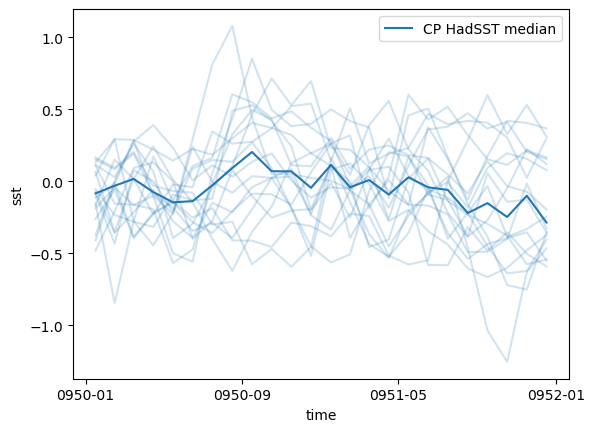

In [21]:
lines = DMI_exp(CP_HAD_ANOM).plot(hue = "exp", c="tab:blue", alpha = 0.2, add_legend=False)
DMI_exp(CP_HAD_ANOM).median("exp").plot( c="tab:blue", label = "CP HadSST median")
plt.legend()

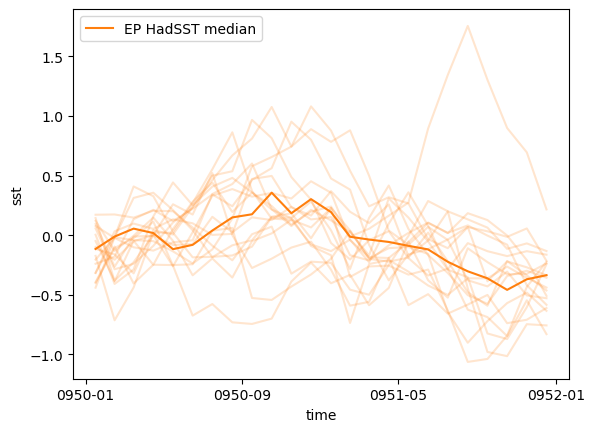

In [22]:

lines = DMI_exp(EP_HAD_ANOM).plot(hue = "exp", c="tab:orange", alpha = 0.2, add_legend=False)
DMI_exp(EP_MOD_ANOM).median("exp").plot(c="tab:orange", label = "EP HadSST median")
plt.legend()

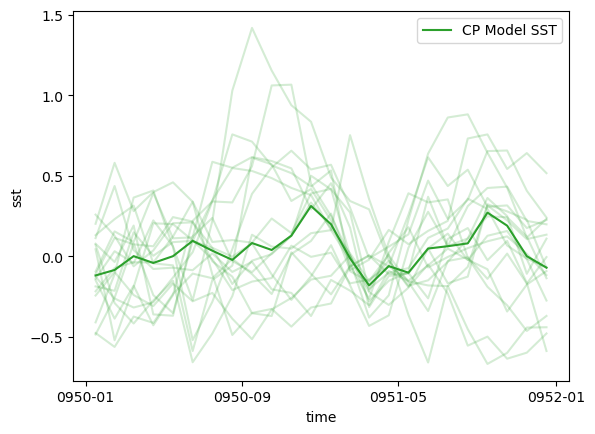

In [23]:
lines = DMI_exp(CP_MOD_ANOM).plot(hue = "exp", c="tab:green", alpha = 0.2, add_legend=False)
DMI_exp(CP_MOD_ANOM).median("exp").plot(c = "tab:green", label = "CP Model SST")
plt.legend()

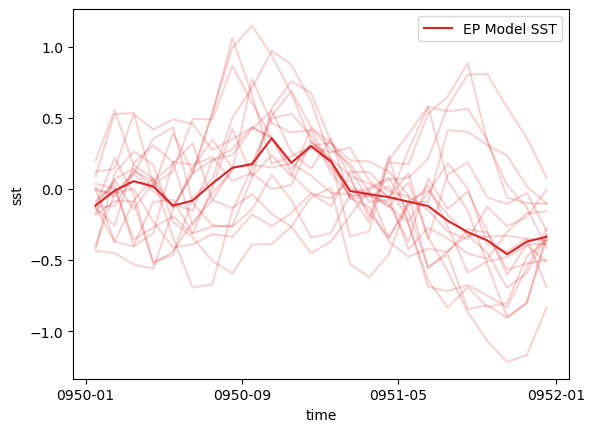

In [24]:
lines = DMI_exp(EP_MOD_ANOM).plot(hue = "exp", c="tab:red", alpha = 0.2, add_legend=False)
DMI_exp(EP_MOD_ANOM).median("exp").plot(c = "tab:red", label = "EP Model SST")
plt.legend()

In [25]:
#get the members that have IOD in SON

In [26]:
def get_IOD_members(EXP, TH):
    DMI = DMI_exp(EXP)
    #look between July and december
    TS = DMI.sel(time=slice("0950-06-01", "0950-12-31"))
    TS2 = DMI.where(TS.exp == TS.where(TS>=TH, drop =True).exp)
    return TS2

In [61]:
def get_IOB_members(EXP, TH):
    DMI = IOBM(EXP)
    #look between July and december
    TS = DMI.sel(time=slice("0950-12-01", "0951-05-31"))
    TS2 = DMI.where(TS.exp == TS.where(TS>=TH, drop =True).exp)
    return TS2

In [63]:
TH_IOB = IOBM(ssta(ctrl)).groupby("time.season")["MAM"].std("time").values

In [34]:
TH = DMI_ctrl(ctrl).groupby("time.season")["SON"].std("time").values

In [35]:
TH

array(0.57186764)

In [65]:
CP_MOD_IOB = get_IOB_members(CP_MOD_ANOM, TH_IOB)
EP_MOD_IOB = get_IOB_members(EP_MOD_ANOM, TH_IOB)
CP_HAD_IOB = get_IOB_members(CP_HAD_ANOM, TH_IOB)
EP_HAD_IOB = get_IOB_members(EP_HAD_ANOM, TH_IOB)

In [32]:
CP_MOD_IOD = get_IOD_members(CP_MOD_ANOM, TH)
EP_MOD_IOD = get_IOD_members(EP_MOD_ANOM, TH)
CP_HAD_IOD = get_IOD_members(CP_HAD_ANOM, TH)
EP_HAD_IOD = get_IOD_members(EP_HAD_ANOM, TH)

Text(0.5, 1.0, 'DMI (CP El Nino Model SST)')

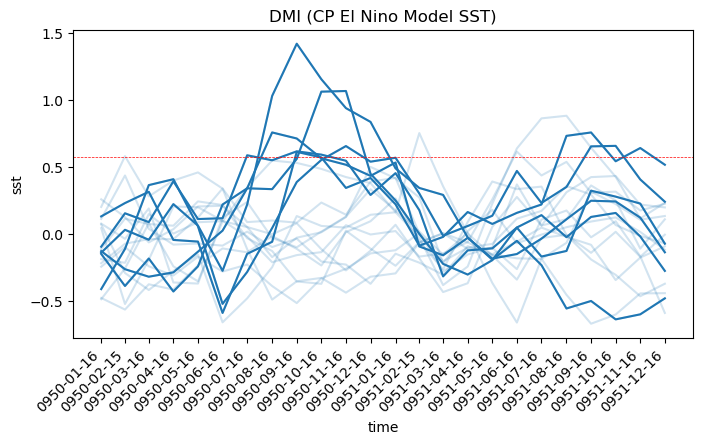

In [41]:
plt.figure(figsize = (8,4))
CP_MOD_IOD.plot(hue = "exp", c = "tab:blue", add_legend = False)#label = f"CP mod pIOD median, n = {len(CP_MOD_IOD.exp)}")
DMI_exp(CP_MOD_ANOM).plot(hue = "exp", c = "tab:blue", alpha = 0.2, add_legend = False)
plt.xticks(CP_MOD_ANOM["time"].values, rotation = 45, ha='right')
plt.axhline(TH, c = 'r', linestyle = "--", lw = 0.5)
#plt.legend()
plt.title("DMI (CP El Nino Model SST)")

Text(0.5, 1.0, 'DMI (EP El Nino Model SST)')

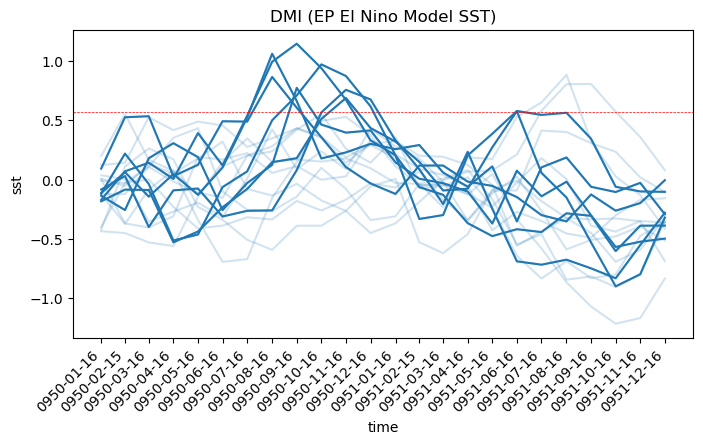

In [42]:
plt.figure(figsize = (8,4))
EP_MOD_IOD.plot(hue = "exp", c = "tab:blue", add_legend = False)#label = f"CP mod pIOD median, n = {len(CP_MOD_IOD.exp)}")
DMI_exp(EP_MOD_ANOM).plot(hue = "exp", c = "tab:blue", alpha = 0.2, add_legend = False)
plt.xticks(EP_MOD_ANOM["time"].values, rotation = 45, ha='right')
plt.axhline(TH, c = 'r', linestyle = "--", lw = 0.5)
#plt.legend()
plt.title("DMI (EP El Nino Model SST)")

Text(0.5, 1.0, 'DMI (CP El Nino HadSST)')

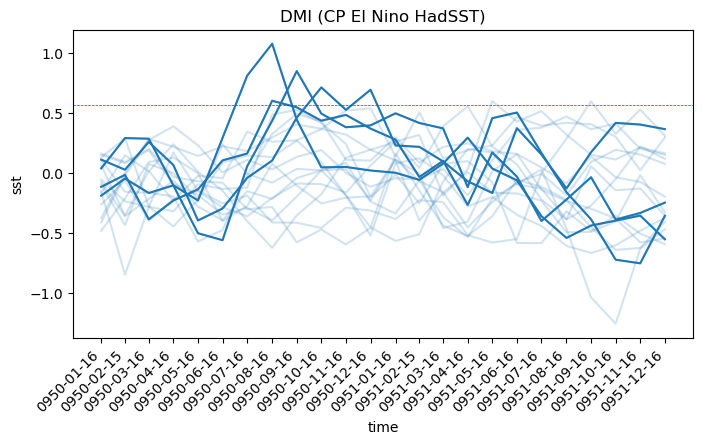

In [43]:
plt.figure(figsize = (8,4))
CP_HAD_IOD.plot(hue = "exp", c = "tab:blue", add_legend = False)#label = f"CP mod pIOD median, n = {len(CP_MOD_IOD.exp)}")
DMI_exp(CP_HAD_ANOM).plot(hue = "exp", c = "tab:blue", alpha = 0.2, add_legend = False)
plt.xticks(CP_HAD_ANOM["time"].values, rotation = 45, ha='right')
plt.axhline(TH, c = 'r', linestyle = "--", lw = 0.5)
#plt.legend()
plt.title("DMI (CP El Nino HadSST)")

Text(0.5, 1.0, 'DMI (EP El Nino HadSST)')

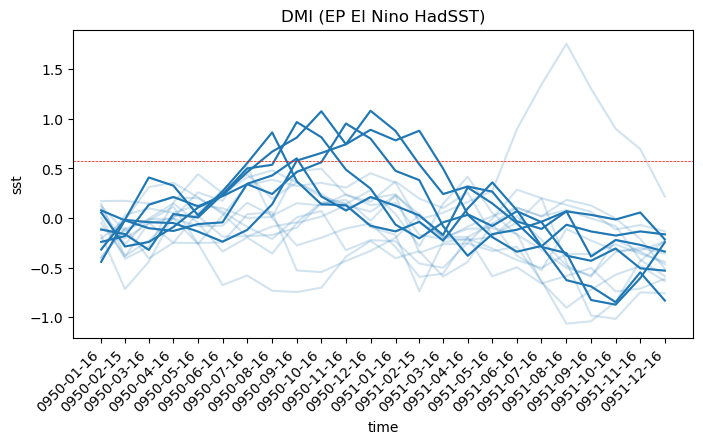

In [44]:
plt.figure(figsize = (8,4))
EP_HAD_IOD.plot(hue = "exp", c = "tab:blue", add_legend = False)#label = f"CP mod pIOD median, n = {len(CP_MOD_IOD.exp)}")
DMI_exp(EP_HAD_ANOM).plot(hue = "exp", c = "tab:blue", alpha = 0.2, add_legend = False)
plt.xticks(EP_HAD_ANOM["time"].values, rotation = 45, ha='right')
plt.axhline(TH, c = 'r', linestyle = "--", lw = 0.5)
#plt.legend()
plt.title("DMI (EP El Nino HadSST)")

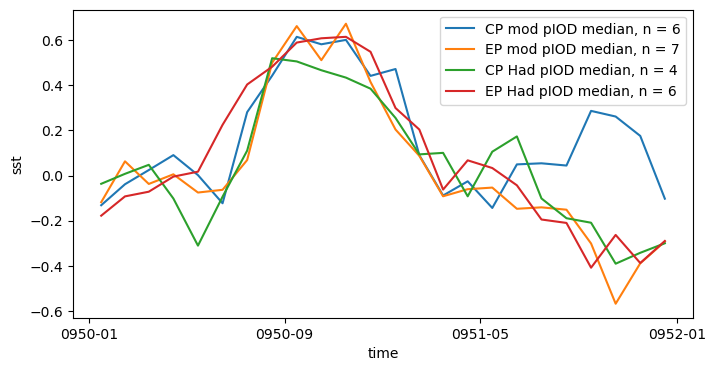

In [45]:
plt.figure(figsize = (8,4))
CP_MOD_IOD.median("exp").plot(label = f"CP mod pIOD median, n = {len(CP_MOD_IOD.exp)}")
EP_MOD_IOD.median("exp").plot(label = f"EP mod pIOD median, n = {len(EP_MOD_IOD.exp)}")
CP_HAD_IOD.median("exp").plot(label = f"CP Had pIOD median, n = {len(CP_HAD_IOD.exp)}")
EP_HAD_IOD.median("exp").plot(label = f"EP Had pIOD median, n = {len(EP_HAD_IOD.exp)}")
plt.legend()

Text(0.5, 1.0, 'IOB (EP El Nino Model SST)')

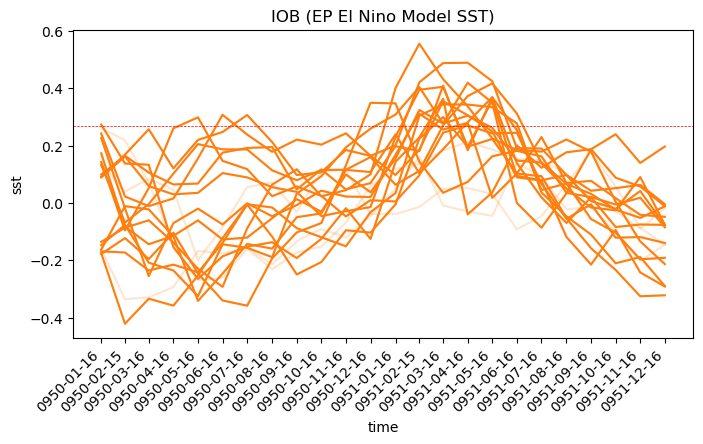

In [69]:
plt.figure(figsize = (8,4))
EP_MOD_IOB.plot(hue = "exp", c = "tab:orange", add_legend = False)#label = f"CP mod pIOD median, n = {len(CP_MOD_IOD.exp)}")
IOBM(EP_MOD_ANOM).plot(hue = "exp", c = "tab:orange", alpha = 0.2, add_legend = False)
plt.xticks(CP_MOD_ANOM["time"].values, rotation = 45, ha='right')
plt.axhline(TH_IOB, c = 'r', linestyle = "--", lw = 0.5)
#plt.legend()
plt.title("IOB (EP El Nino Model SST)")

Text(0.5, 1.0, 'IOB (EP El Nino HadSST)')

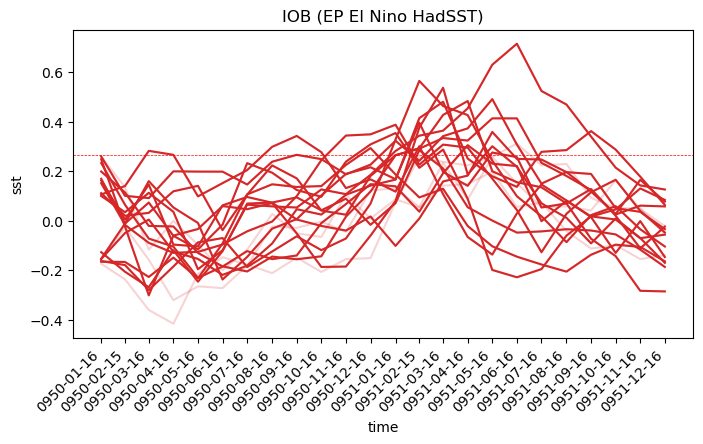

In [71]:
plt.figure(figsize = (8,4))
EP_HAD_IOB.plot(hue = "exp", c = "tab:red", add_legend = False)#label = f"CP mod pIOD median, n = {len(CP_MOD_IOD.exp)}")
IOBM(EP_HAD_ANOM).plot(hue = "exp", c = "tab:red", alpha = 0.2, add_legend = False)
plt.xticks(CP_MOD_ANOM["time"].values, rotation = 45, ha='right')
plt.axhline(TH_IOB, c = 'r', linestyle = "--", lw = 0.5)
#plt.legend()
plt.title("IOB (EP El Nino HadSST)")

Text(0.5, 1.0, 'IOB (CP El Nino HadSST)')

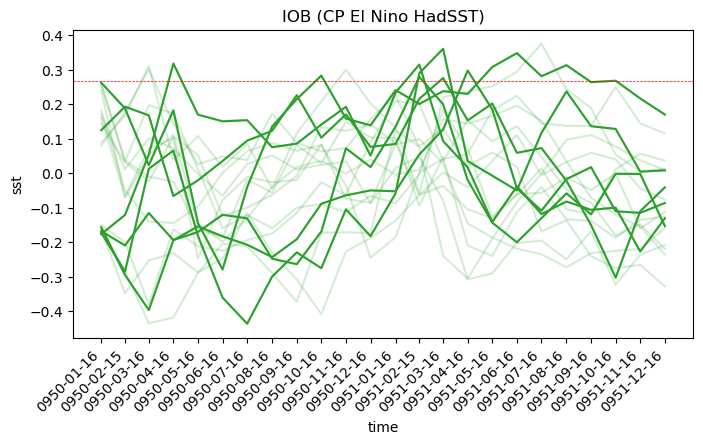

In [72]:
plt.figure(figsize = (8,4))
CP_HAD_IOB.plot(hue = "exp", c = "tab:green", add_legend = False)#label = f"CP mod pIOD median, n = {len(CP_MOD_IOD.exp)}")
IOBM(CP_HAD_ANOM).plot(hue = "exp", c = "tab:green", alpha = 0.2, add_legend = False)
plt.xticks(CP_MOD_ANOM["time"].values, rotation = 45, ha='right')
plt.axhline(TH_IOB, c = 'r', linestyle = "--", lw = 0.5)
#plt.legend()
plt.title("IOB (CP El Nino HadSST)")

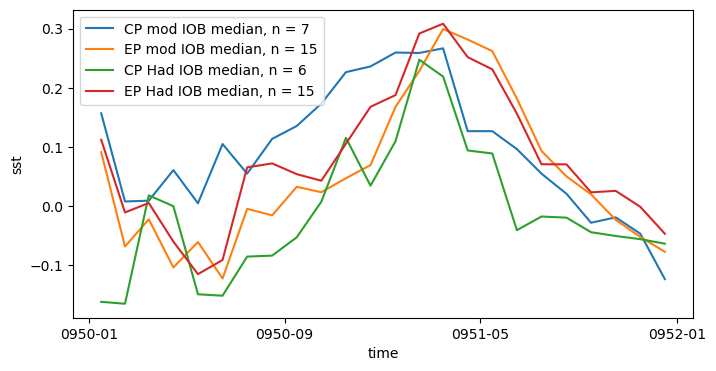

In [74]:
plt.figure(figsize = (8,4))
CP_MOD_IOB.median("exp").plot(label = f"CP mod IOB median, n = {len(CP_MOD_IOB.exp)}")
EP_MOD_IOB.median("exp").plot(label = f"EP mod IOB median, n = {len(EP_MOD_IOB.exp)}")
CP_HAD_IOB.median("exp").plot(label = f"CP Had IOB median, n = {len(CP_HAD_IOB.exp)}")
EP_HAD_IOB.median("exp").plot(label = f"EP Had IOB median, n = {len(EP_HAD_IOB.exp)}")
plt.legend()

Text(0.5, 1.0, 'Nino34 index')

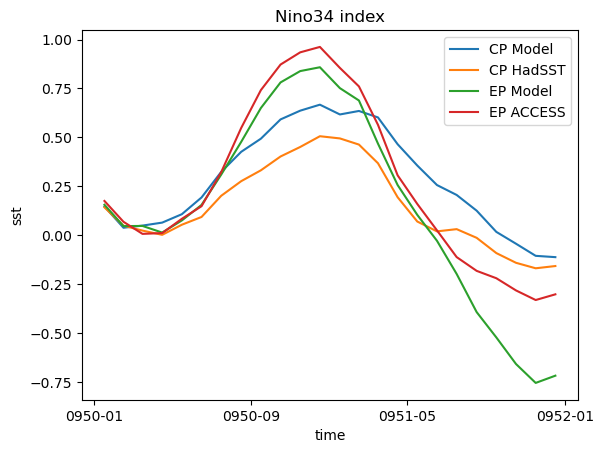

In [78]:
NINO34(CP_MOD_ANOM).mean("exp").plot(label = "CP Model")#hue = "exp")
NINO34(CP_HAD_ANOM).mean("exp").plot(label = "CP HadSST")#hue = "exp")
NINO34(EP_MOD_ANOM).mean("exp").plot(label = "EP Model")#hue = "exp")
NINO34(EP_HAD_ANOM).mean("exp").plot(label = "EP ACCESS")#hue = "exp")
plt.legend()
plt.title("Nino34 index")

Text(0.5, 1.0, 'DMI')

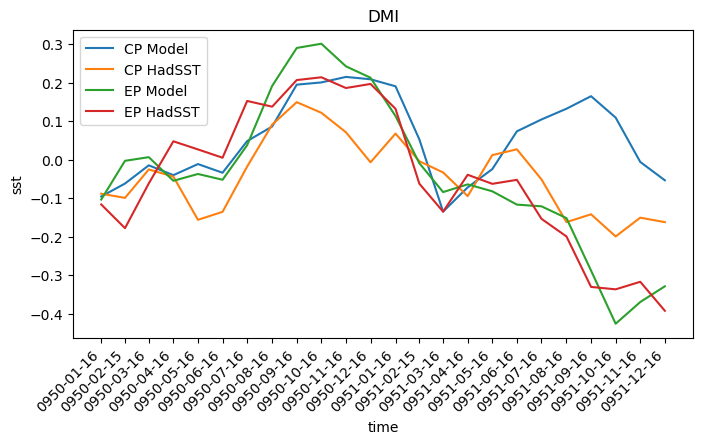

In [87]:
plt.figure(figsize = (8,4))
DMI_exp(CP_MOD_ANOM).mean("exp").plot(label = "CP Model")#hue = "exp")
DMI_exp(CP_HAD_ANOM).mean("exp").plot(label = "CP HadSST")#hue = "exp")
DMI_exp(EP_MOD_ANOM).mean("exp").plot(label = "EP Model")#hue = "exp")
DMI_exp(EP_HAD_ANOM).mean("exp").plot(label = "EP HadSST")#hue = "exp")
plt.legend()
plt.xticks(CP_MOD_ANOM["time"].values, rotation = 45, ha='right')
plt.title("DMI")

In [59]:
from scipy.stats import ttest_1samp, ttest_rel, ttest_ind

In [80]:
ttest_rel(DMI_exp(CP_HAD_ANOM), DMI_exp(EP_HAD_ANOM))[1]

array([0.07320764, 0.19758402, 0.68416882, 0.18107347, 0.04319818,
       0.1388271 , 0.10329418, 0.66021852, 0.61375604, 0.48777267,
       0.32996938, 0.09484083, 0.51780574, 0.54845234, 0.21211003,
       0.58518572, 0.36960187, 0.45502355, 0.4218502 , 0.82425425,
       0.33923068, 0.44102888, 0.25857587, 0.03851984])

In [81]:
ttest_rel(DMI_exp(CP_MOD_ANOM), DMI_exp(EP_MOD_ANOM))[1]

array([6.79987898e-01, 2.57184954e-01, 7.36391574e-01, 8.90199502e-01,
       7.44634805e-01, 8.56729035e-01, 9.27792175e-01, 5.07483086e-01,
       5.02556828e-01, 4.62758253e-01, 8.26846890e-01, 9.71561896e-01,
       3.09930532e-01, 3.44690738e-01, 4.03513168e-01, 9.01827276e-01,
       4.52707604e-01, 1.61306774e-01, 8.75858710e-02, 7.05502652e-02,
       3.90587222e-03, 4.52312145e-04, 6.92401537e-04, 6.51968954e-03])

In [82]:
ttest_rel(DMI_exp(EP_MOD_ANOM), DMI_exp(EP_HAD_ANOM))[1]

array([0.511041  , 0.0241734 , 0.4440213 , 0.23892114, 0.43390567,
       0.56067808, 0.36693647, 0.72751592, 0.59607725, 0.57255374,
       0.66643034, 0.9077721 , 0.86793065, 0.67258484, 0.57957089,
       0.7685284 , 0.80306636, 0.65109615, 0.83546726, 0.78038043,
       0.78389459, 0.53607751, 0.62356555, 0.34279862])

In [83]:
ttest_rel(DMI_exp(CP_MOD_ANOM), DMI_exp(CP_HAD_ANOM))[1]

array([0.60450993, 0.62965066, 0.88636346, 0.96867596, 0.0909043 ,
       0.26605108, 0.46782275, 0.96824075, 0.69524385, 0.53265993,
       0.2137528 , 0.05237019, 0.13889129, 0.5041584 , 0.09806128,
       0.73687501, 0.65978387, 0.67018999, 0.06103482, 0.02555031,
       0.06091351, 0.06100785, 0.23989138, 0.30564651])

In [ ]:
#now lets do ttest between experiments to determine if they are different

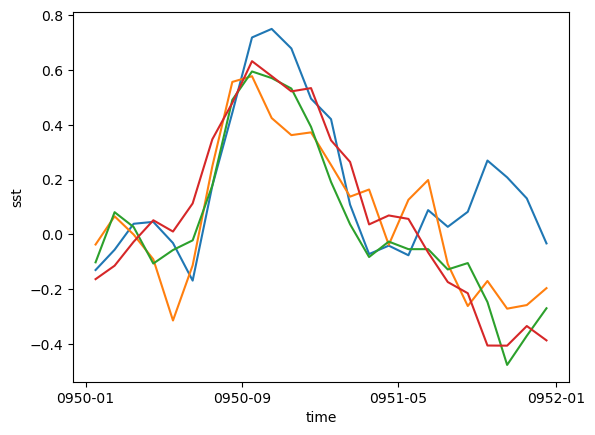

In [28]:
get_IOD_members(CP_MOD_ANOM, TH).mean("exp").plot()#hue = "exp")
get_IOD_members(CP_HAD_ANOM, TH).mean("exp").plot()#hue = "exp")
get_IOD_members(EP_MOD_ANOM, TH).mean("exp").plot()#hue = "exp")
get_IOD_members(EP_HAD_ANOM, TH).mean("exp").plot()#hue = "exp")


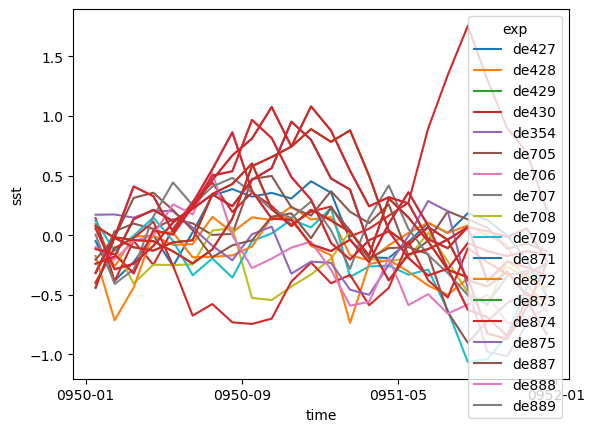

In [61]:
#get_IOD_members(CP_MOD_ANOM, TH).plot(hue = "exp", c = "tab:blue", add_legend=False)
#get_IOD_members(CP_HAD_ANOM, TH).plot(hue = "exp", c = "tab:orange", add_legend=False)
#get_IOD_members(EP_MOD_ANOM, TH).plot(hue = "exp", c = "tab:green", add_legend=False)
DMI_exp(EP_HAD_ANOM).plot(hue="exp")
get_IOD_members(EP_HAD_ANOM, TH).plot(hue = "exp", c = "tab:red", add_legend=False)

In [30]:
cpd = DMI_exp(CP_MOD_ANOM)

In [32]:
TH = DMI_ctrl(ctrl).groupby("time.season")["SON"].std("time").values

In [33]:
TH

array(0.57186764)

In [46]:
TS = cpd.sel(time=slice("0950-07-01", "0950-12-31"))

In [49]:
TS.where(TS>=TH, drop =True).exp.values

array(['de423', 'de353', 'de701', 'de702', 'de867', 'de869'], dtype='<U5')

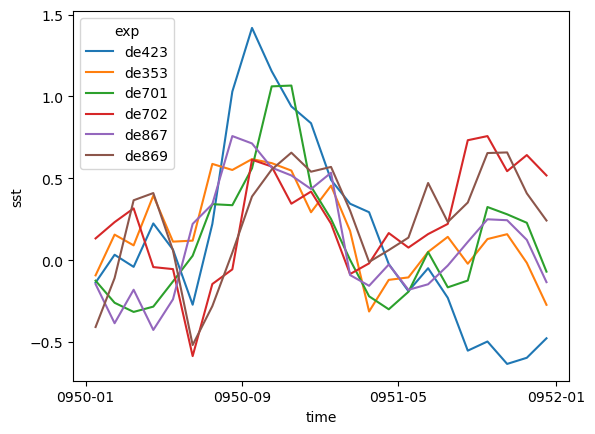

In [51]:
cpd.where(cpd.exp == TS.where(TS>=TH, drop =True).exp).plot(hue = "exp")

In [44]:
test = xr.where(cpd.sel(time=slice("0950-07-01", "0950-12-31"))>=TH, cpd.sel(time=slice("0950-07-01", "0950-12-31")), np.nan)

In [45]:
test

<xarray.DataArray 'sst' (exp: 18, time: 6)>
dask.array<where, shape=(18, 6), dtype=float32, chunksize=(1, 6), chunktype=numpy.ndarray>
Coordinates:
  * time     (time) object 0950-07-16 12:00:00 ... 0950-12-16 12:00:00
  * exp      (exp) <U5 'de423' 'de424' 'de425' ... 'de884' 'de885' 'de886'
    month    (time) int64 7 8 9 10 11 12

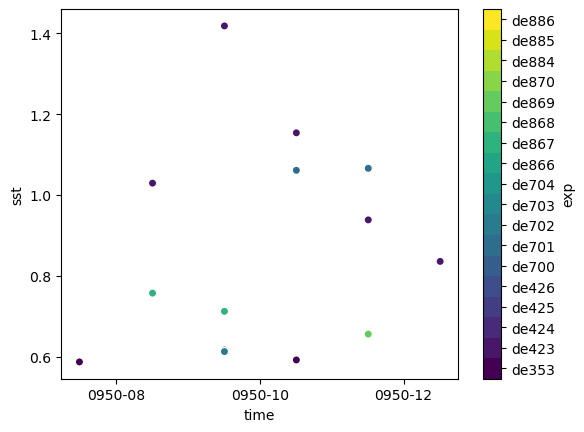

In [43]:
xr.where(cpd.sel(time=slice("0950-07-01", "0950-12-31"))>=TH, cpd.sel(time=slice("0950-07-01", "0950-12-31")), np.nan).plot.scatter(hue = "exp")

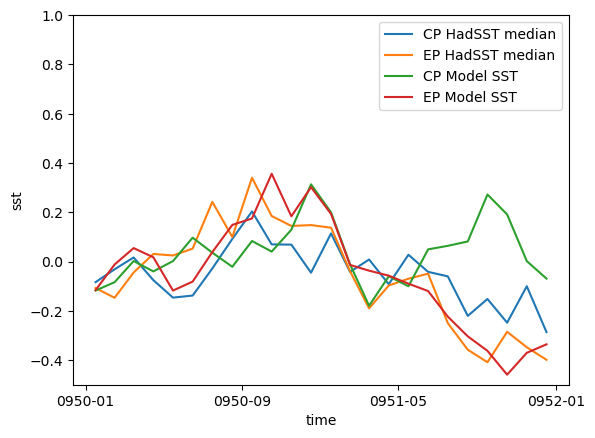

In [79]:
#lines = DMI_exp(CP_HAD_ANOM).plot(hue = "exp", c="tab:blue", alpha = 0.2, add_legend=False)
DMI_exp(CP_HAD_ANOM).median("exp").plot( c="tab:blue", label = "CP HadSST median")

#lines = DMI_exp(EP_HAD_ANOM).plot(hue = "exp", c="tab:orange", alpha = 0.2, add_legend=False)
DMI_exp(EP_HAD_ANOM).median("exp").plot(c="tab:orange", label = "EP HadSST median")

#lines = DMI_exp(CP_MOD_ANOM).plot(hue = "exp", c="tab:green", alpha = 0.2, add_legend=False)
DMI_exp(CP_MOD_ANOM).median("exp").plot(c = "tab:green", label = "CP Model SST")

#lines = DMI_exp(EP_MOD_ANOM).plot(hue = "exp", c="tab:pink", alpha = 0.2, add_legend=False)
DMI_exp(EP_MOD_ANOM).median("exp").plot(c = "tab:red", label = "EP Model SST")
plt.ylim(-0.5, 1)
plt.legend()

In [83]:
#get the members which are over the threshold in July to December

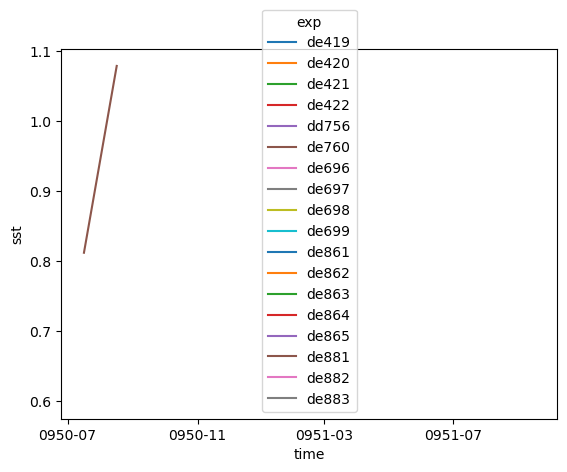

In [86]:
DMI_exp(CP_HAD_ANOM).where(DMI_exp(CP_HAD_ANOM) > (DMI_ctrl(ctrl).groupby("time.season")["SON"].std("time").values)).plot(hue = "exp")

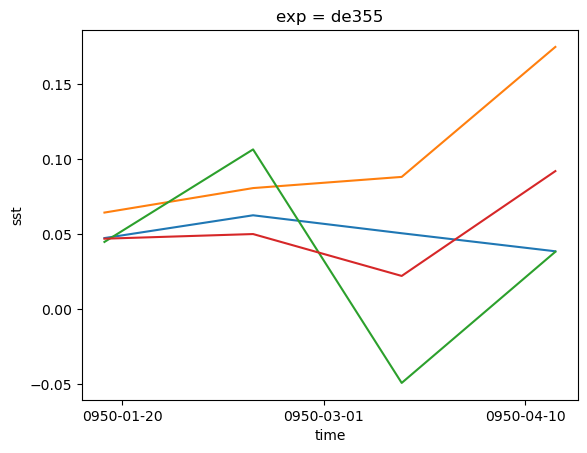

In [64]:
NINO4(CP_HAD_ANOM).sel(time = slice("0950-01-01", "0950-05-01")).sel(exp = "dd756").plot()
NINO4(CP_MOD_ANOM).sel(time = slice("0950-01-01", "0950-05-01")).sel(exp = "de353").plot()
NINO4(EP_HAD_ANOM).sel(time = slice("0950-01-01", "0950-05-01")).sel(exp = "de354").plot()
NINO4(EP_MOD_ANOM).sel(time = slice("0950-01-01", "0950-05-01")).sel(exp = "de355").plot()


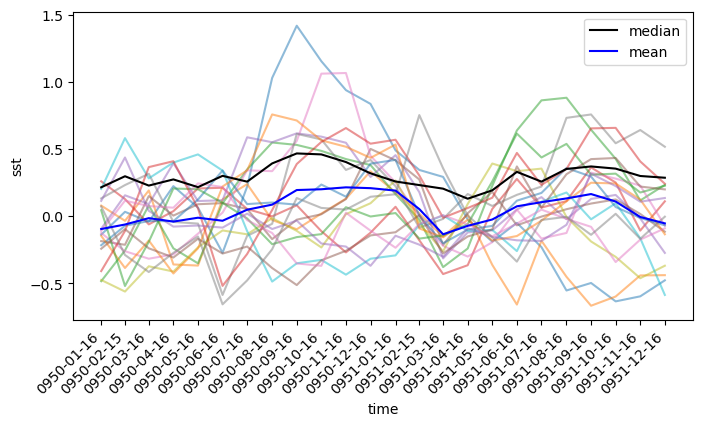

In [65]:
plt.figure(figsize = (8,4))
DMI_exp(CP_MOD_ANOM).plot(x = "time", hue = "exp", alpha = 0.5)
DMI_exp(CP_MOD_ANOM).std("exp").plot(c = "k", label = "median")
DMI_exp(CP_MOD_ANOM).mean("exp").plot(c = "b", label = "mean")
plt.xticks(CP_MOD_ANOM["time"].values, rotation = 45, ha='right')
sns.move_legend(plt.gca(), loc='center left', bbox_to_anchor=(1, 0.5))
plt.legend()
# Move legend outside the plot
#plt.legend(plot, bbox_to_anchor=(1, 0.5))


In [ ]:
IOBM(CP_MOD_ANOM).median("exp").plot(label = "CP Model")
IOBM(EP_MOD_ANOM).median("exp").plot(label = "EP Model")
IOBM(CP_HAD_ANOM).median("exp").plot(label = "CP HAD")
IOBM(EP_HAD_ANOM).median("exp").plot(label = "EP HAD")
plt.legend()

In [ ]:
DMI_exp(CP_MOD_ANOM).median("exp").plot(label = "CP Model")
DMI_exp(EP_MOD_ANOM).median("exp").plot(label = "EP Model")
DMI_exp(CP_HAD_ANOM).median("exp").plot(label = "CP HAD")
DMI_exp(EP_HAD_ANOM).median("exp").plot(label = "EP HAD")
plt.legend()

In [ ]:
NINO34(CP_MOD_ANOM).median("exp").plot(label = "CP Model")
NINO34(EP_MOD_ANOM).median("exp").plot(label = "EP Model")
NINO34(CP_HAD_ANOM).median("exp").plot(label = "CP HAD")
NINO34(EP_HAD_ANOM).median("exp").plot(label = "EP HAD")
plt.legend()

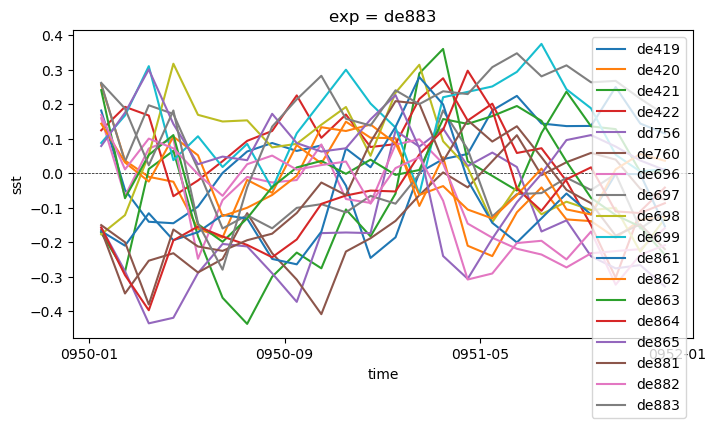

In [56]:
#plot figure
plt.figure(figsize = (8,4))
#now plot the 0 line and DMI threshold line
#plt.axhline(DMI_ctrl(ctrl).groupby("time.season")["SON"].std("time").values, lw = 0.5, color = 'r')
plt.axhline(0, lw = 0.5, ls = "--", color = 'k')
for key in CP_had_ens.keys():
    sst = CP_had_ens[key]
    SSTA = sst.groupby("time.month") - ctrl.groupby("time.month").mean("time")
    #give the
    nino4 = IOBM(SSTA)
    nino4.plot(label = key)
plt.legend()


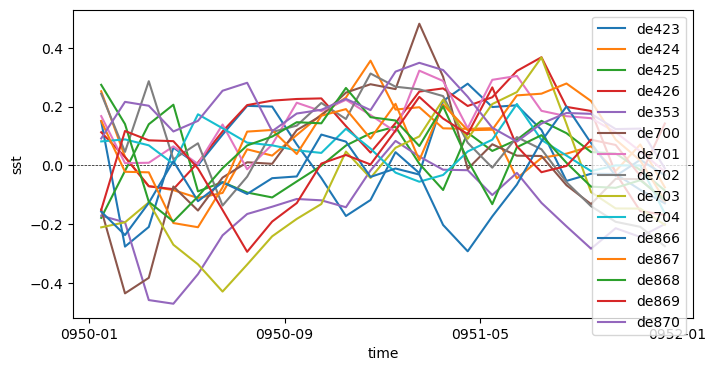

In [17]:
#plot figure
plt.figure(figsize = (8,4))
#now plot the 0 line and DMI threshold line
#plt.axhline(DMI_ctrl(ctrl).groupby("time.season")["SON"].std("time").values, lw = 0.5, color = 'r')
plt.axhline(0, lw = 0.5, ls = "--", color = 'k')
for key in CP_mod_ens.keys():
    sst = CP_mod_ens[key]
    SSTA = sst.groupby("time.month") - ctrl.groupby("time.month").mean("time")
    #give the
    nino4 = IOBM(SSTA)
    nino4.plot(label = key)
plt.legend()


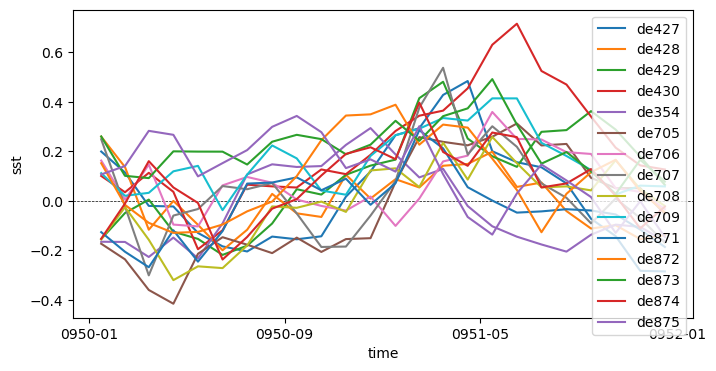

In [18]:
#plot figure
plt.figure(figsize = (8,4))
#now plot the 0 line and DMI threshold line
#plt.axhline(DMI_ctrl(ctrl).groupby("time.season")["SON"].std("time").values, lw = 0.5, color = 'r')
plt.axhline(0, lw = 0.5, ls = "--", color = 'k')
for key in EP_had_ens.keys():
    sst = EP_had_ens[key]
    SSTA = sst.groupby("time.month") - ctrl.groupby("time.month").mean("time")
    #give the
    nino4 = IOBM(SSTA)
    nino4.plot(label = key)
plt.legend()


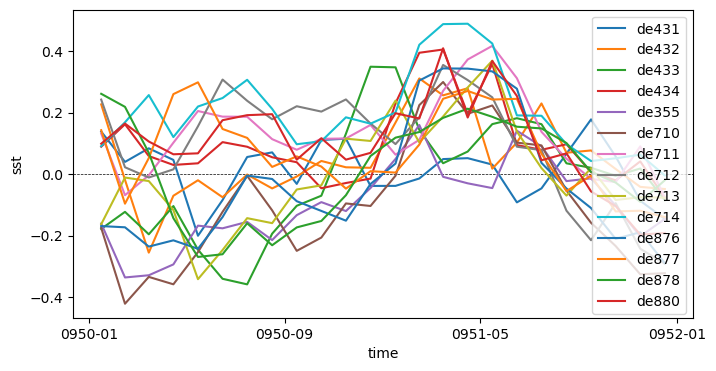

In [19]:
#plot figure
plt.figure(figsize = (8,4))
#now plot the 0 line and DMI threshold line
#plt.axhline(DMI_ctrl(ctrl).groupby("time.season")["SON"].std("time").values, lw = 0.5, color = 'r')
plt.axhline(0, lw = 0.5, ls = "--", color = 'k')
for key in EP_mod_ens.keys():
    sst = EP_mod_ens[key]
    SSTA = sst.groupby("time.month") - ctrl.groupby("time.month").mean("time")
    #give the
    nino4 = IOBM(SSTA)
    nino4.plot(label = key)
plt.legend()


In [25]:
#look at GMSST

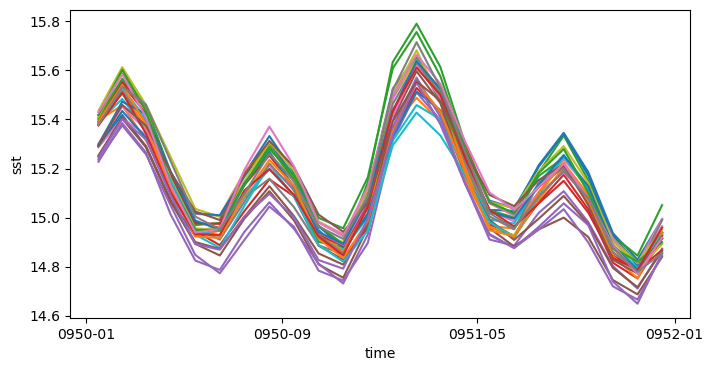

In [39]:
#plot figure
plt.figure(figsize = (8,4))
#now plot the 0 line and DMI threshold line
#plt.axhline(DMI_ctrl(ctrl).groupby("time.season")["SON"].std("time").values, lw = 0.5, color = 'r')
#plt.axhline(0, lw = 0.5, ls = "--", color = 'k')
i = 0
for key in CP_had_ens.keys():
    sst = CP_had_ens[key]
    GMSST = sst.mean(['yt_ocean', 'xt_ocean'])
    #SSTA = sst.groupby("time.month") - ctrl.groupby("time.month").mean("time")
    #give the
    #dmi = DMI_exp(SSTA)
    GMSST.plot()
    i = i+1
i = 0
for key in CP_mod_ens.keys():
    sst = CP_mod_ens[key]
    GMSST = sst.mean(['yt_ocean', 'xt_ocean'])
    #SSTA = sst.groupby("time.month") - ctrl.groupby("time.month").mean("time")
    #give the
    #dmi = DMI_exp(SSTA)
    GMSST.plot()
    i = i+1
i = 0
for key in EP_mod_ens.keys():
    sst = EP_mod_ens[key]
    GMSST = sst.mean(['yt_ocean', 'xt_ocean'])
    #SSTA = sst.groupby("time.month") - ctrl.groupby("time.month").mean("time")
    #give the
    #dmi = DMI_exp(SSTA)
    GMSST.plot()
    i = i+1

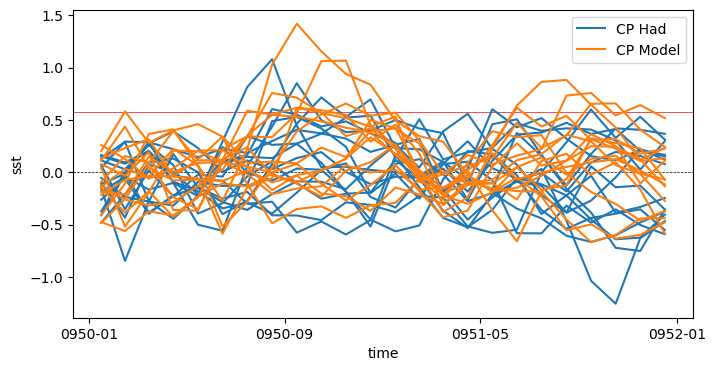

In [15]:
#plot figure
plt.figure(figsize = (8,4))
#now plot the 0 line and DMI threshold line
plt.axhline(DMI_ctrl(ctrl).groupby("time.season")["SON"].std("time").values, lw = 0.5, color = 'r')
plt.axhline(0, lw = 0.5, ls = "--", color = 'k')
i = 0
for key in CP_had_ens.keys():
    sst = CP_had_ens[key]
    SSTA = sst.groupby("time.month") - ctrl.groupby("time.month").mean("time")
    #give the
    dmi = DMI_exp(SSTA)
    if i==0:
        dmi.plot(c = 'tab:blue', label = 'CP Had')
    else:
         dmi.plot(c = 'tab:blue')
    i = i+1

i = 0
for key in CP_mod_ens.keys():
    sst = CP_mod_ens[key]
    SSTA = sst.groupby("time.month") - ctrl.groupby("time.month").mean("time")
    #give the
    dmi = DMI_exp(SSTA)
    if i==0:
        dmi.plot(c = 'tab:orange', label = 'CP Model')
    else:
         dmi.plot(c = 'tab:orange')
    i = i+1    
plt.legend()


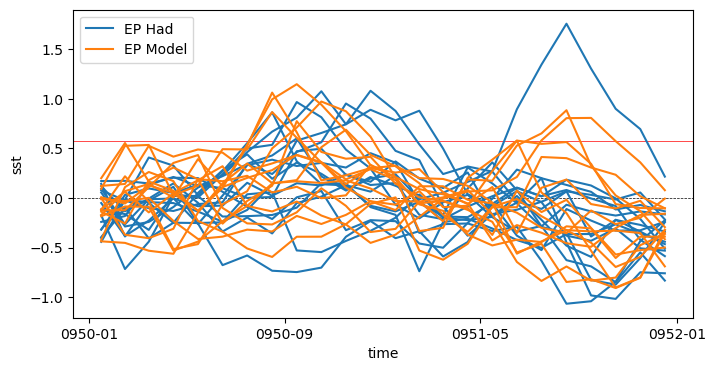

In [16]:
#plot figure
plt.figure(figsize = (8,4))
#now plot the 0 line and DMI threshold line
plt.axhline(DMI_ctrl(ctrl).groupby("time.season")["SON"].std("time").values, lw = 0.5, color = 'r')
plt.axhline(0, lw = 0.5, ls = "--", color = 'k')
i = 0
for key in EP_had_ens.keys():
    sst = EP_had_ens[key]
    SSTA = sst.groupby("time.month") - ctrl.groupby("time.month").mean("time")
    #give the
    dmi = DMI_exp(SSTA)
    if i==0:
        dmi.plot(c = 'tab:blue', label = 'EP Had')
    else:
         dmi.plot(c = 'tab:blue')
    i = i+1
i = 0
for key in EP_mod_ens.keys():
    sst = EP_mod_ens[key]
    SSTA = sst.groupby("time.month") - ctrl.groupby("time.month").mean("time")
    #give the
    dmi = DMI_exp(SSTA)
    if i==0:
        dmi.plot(c = 'tab:orange', label = 'EP Model')
    else:
         dmi.plot(c = 'tab:orange')
    i = i+1
plt.legend()

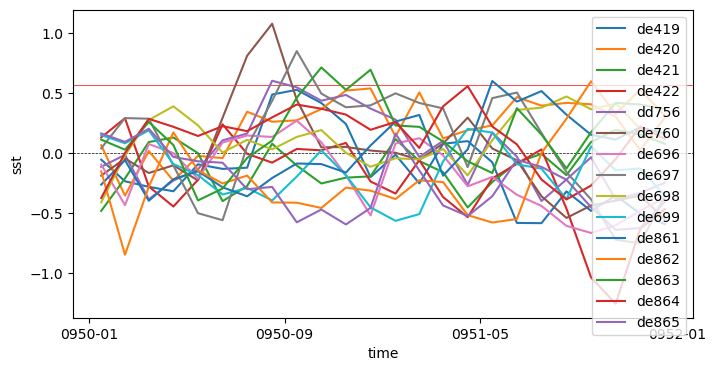

In [17]:
#plot figure
plt.figure(figsize = (8,4))
#now plot the 0 line and DMI threshold line
plt.axhline(DMI_ctrl(ctrl).groupby("time.season")["SON"].std("time").values, lw = 0.5, color = 'r')
plt.axhline(0, lw = 0.5, ls = "--", color = 'k')
for key in CP_had_ens.keys():
    sst = CP_had_ens[key]
    SSTA = sst.groupby("time.month") - ctrl.groupby("time.month").mean("time")
    #give the
    dmi = DMI_exp(SSTA)
    dmi.plot(label = key)
plt.legend()


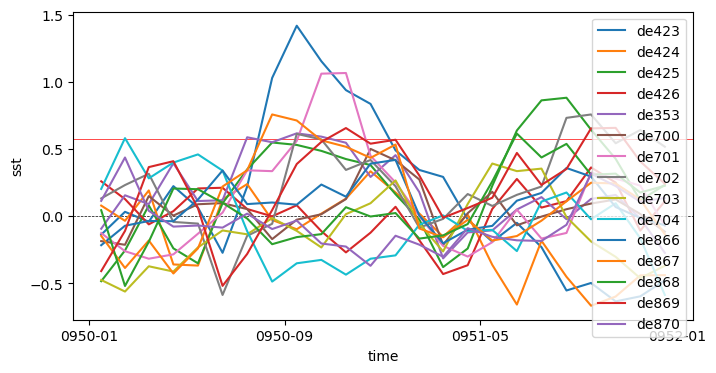

In [18]:
#plot figure
plt.figure(figsize = (8,4))
#now plot the 0 line and DMI threshold line
plt.axhline(DMI_ctrl(ctrl).groupby("time.season")["SON"].std("time").values, lw = 0.5, color = 'r')
plt.axhline(0, lw = 0.5, ls = "--", color = 'k')
for key in CP_mod_ens.keys():
    sst = CP_mod_ens[key]
    SSTA = sst.groupby("time.month") - ctrl.groupby("time.month").mean("time")
    #give the
    dmi = DMI_exp(SSTA)
    dmi.plot(label = key)
plt.legend()


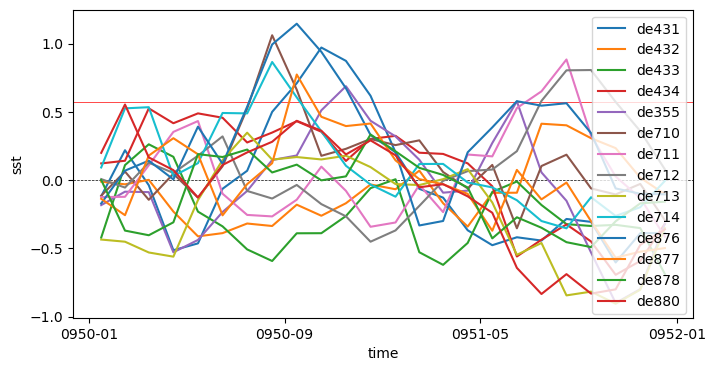

In [19]:
#plot figure
plt.figure(figsize = (8,4))
#now plot the 0 line and DMI threshold line
plt.axhline(DMI_ctrl(ctrl).groupby("time.season")["SON"].std("time").values, lw = 0.5, color = 'r')
plt.axhline(0, lw = 0.5, ls = "--", color = 'k')
for key in EP_mod_ens.keys():
    sst = EP_mod_ens[key]
    SSTA = sst.groupby("time.month") - ctrl.groupby("time.month").mean("time")
    #give the
    dmi = DMI_exp(SSTA)
    dmi.plot(label = key)
plt.legend()


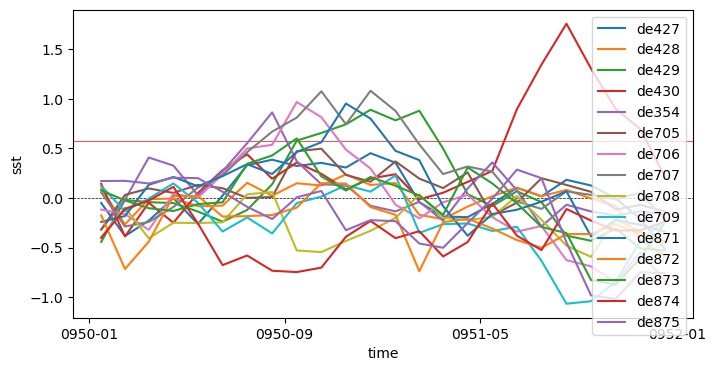

In [20]:
#plot figure
plt.figure(figsize = (8,4))
#now plot the 0 line and DMI threshold line
plt.axhline(DMI_ctrl(ctrl).groupby("time.season")["SON"].std("time").values, lw = 0.5, color = 'r')
plt.axhline(0, lw = 0.5, ls = "--", color = 'k')
for key in EP_had_ens.keys():
    sst = EP_had_ens[key]
    SSTA = sst.groupby("time.month") - ctrl.groupby("time.month").mean("time")
    #give the
    dmi = DMI_exp(SSTA)
    dmi.plot(label = key)
plt.legend()


In [32]:
def NINO4(DS):
    N4 =  (DS).sel(yt_ocean=slice(
         -10, 10),xt_ocean=slice(160, 210)).mean(['yt_ocean', 'xt_ocean'])
    return N4

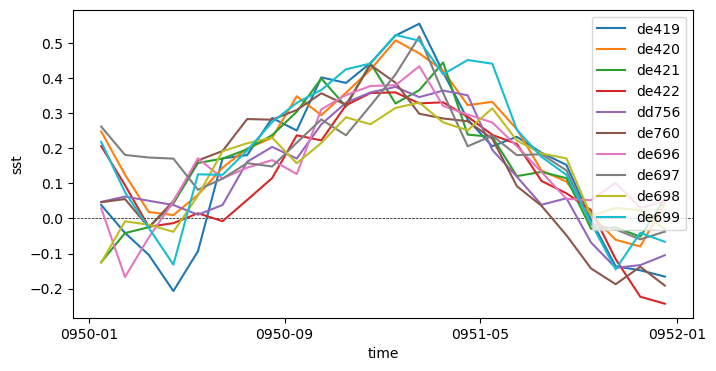

In [33]:
#plot figure
plt.figure(figsize = (8,4))
#now plot the 0 line and DMI threshold line
#plt.axhline(DMI_ctrl(ctrl).groupby("time.season")["SON"].std("time").values, lw = 0.5, color = 'r')
plt.axhline(0, lw = 0.5, ls = "--", color = 'k')
for key in CP_had_ens.keys():
    sst = CP_had_ens[key]
    SSTA = sst.groupby("time.month") - ctrl.groupby("time.month").mean("time")
    #give the
    nino4 = NINO4(SSTA)
    nino4.plot(label = key)
plt.legend()


de760 and dd756 are equivalent members with the perturbation (ornage and blue). All the other members are different restart years

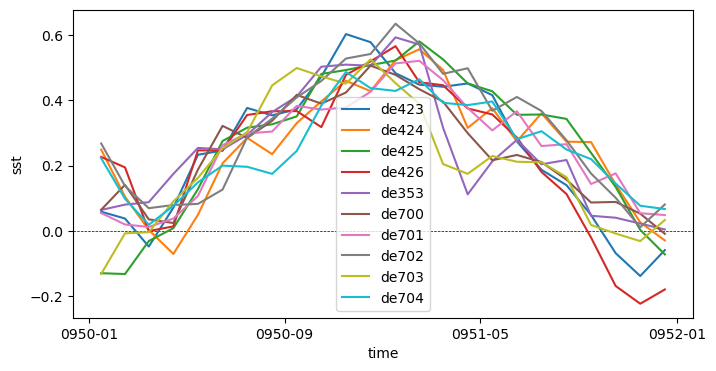

In [35]:
#plot figure
plt.figure(figsize = (8,4))
#now plot the 0 line and DMI threshold line
#plt.axhline(DMI_ctrl(ctrl).groupby("time.season")["SON"].std("time").values, lw = 0.5, color = 'r')
plt.axhline(0, lw = 0.5, ls = "--", color = 'k')
for key in CP_mod_ens.keys():
    sst = CP_mod_ens[key]
    SSTA = sst.groupby("time.month") - ctrl.groupby("time.month").mean("time")
    #give the
    nino4 = NINO4(SSTA)
    nino4.plot(label = key)
plt.legend()


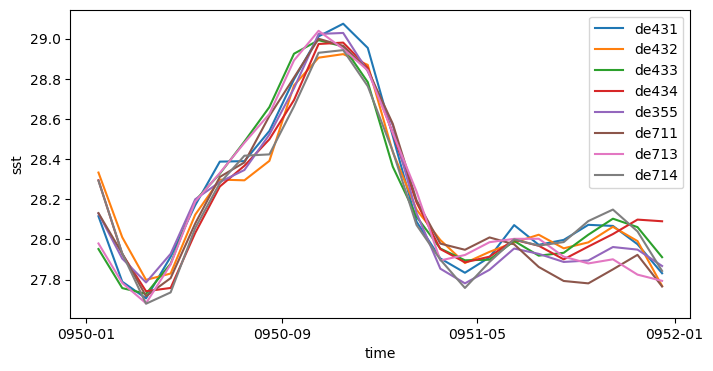

In [37]:
#plot figure
plt.figure(figsize = (8,4))
#now plot the 0 line and DMI threshold line
#plt.axhline(DMI_ctrl(ctrl).groupby("time.season")["SON"].std("time").values, lw = 0.5, color = 'r')
#plt.axhline(0, lw = 0.5, ls = "--", color = 'k')
for key in EP_mod_ens.keys():
    sst = EP_mod_ens[key]
    #SSTA = sst.groupby("time.month") - ctrl.groupby("time.month").mean("time")
    #give the
    nino4 = NINO4(sst)
    nino4.plot(label = key)
plt.legend()


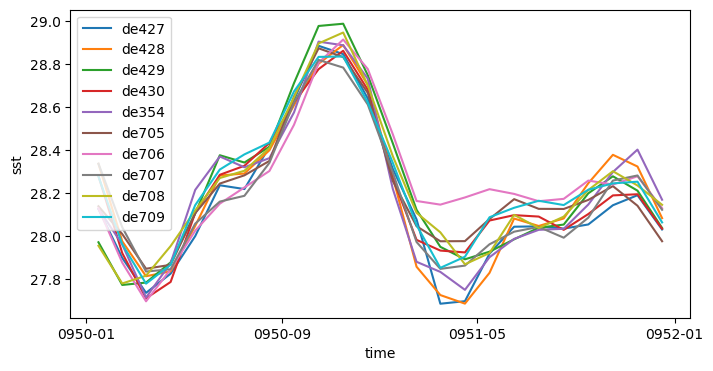

In [38]:
#plot figure
plt.figure(figsize = (8,4))
#now plot the 0 line and DMI threshold line
#plt.axhline(DMI_ctrl(ctrl).groupby("time.season")["SON"].std("time").values, lw = 0.5, color = 'r')
#plt.axhline(0, lw = 0.5, ls = "--", color = 'k')
for key in EP_had_ens.keys():
    sst = EP_had_ens[key]
    #SSTA = sst.groupby("time.month") - ctrl.groupby("time.month").mean("time")
    #give the
    nino4 = NINO4(sst)
    nino4.plot(label = key)
plt.legend()


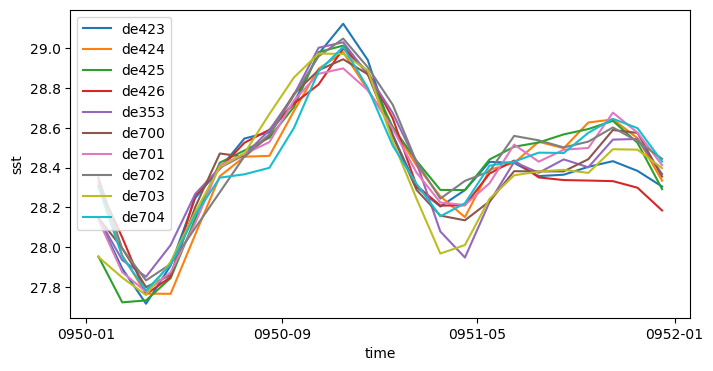

In [36]:
#plot figure
plt.figure(figsize = (8,4))
#now plot the 0 line and DMI threshold line
#plt.axhline(DMI_ctrl(ctrl).groupby("time.season")["SON"].std("time").values, lw = 0.5, color = 'r')
#plt.axhline(0, lw = 0.5, ls = "--", color = 'k')
for key in CP_mod_ens.keys():
    sst = CP_mod_ens[key]
    #SSTA = sst.groupby("time.month") - ctrl.groupby("time.month").mean("time")
    #give the
    nino4 = NINO4(sst)
    nino4.plot(label = key)
plt.legend()


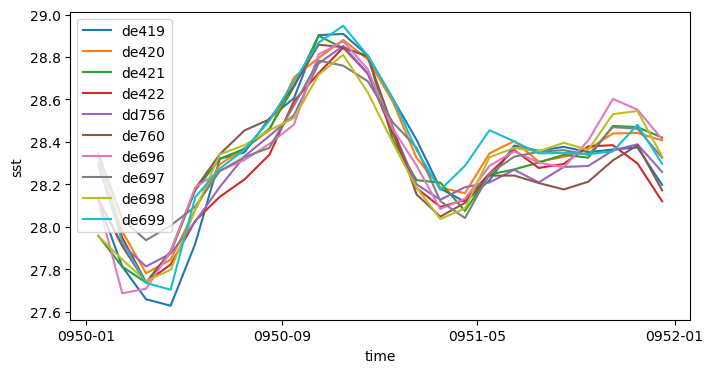

In [34]:
#plot figure
plt.figure(figsize = (8,4))
#now plot the 0 line and DMI threshold line
#plt.axhline(DMI_ctrl(ctrl).groupby("time.season")["SON"].std("time").values, lw = 0.5, color = 'r')
#plt.axhline(0, lw = 0.5, ls = "--", color = 'k')
for key in CP_had_ens.keys():
    sst = CP_had_ens[key]
    #SSTA = sst.groupby("time.month") - ctrl.groupby("time.month").mean("time")
    #give the
    nino4 = NINO4(sst)
    nino4.plot(label = key)
plt.legend()


In [19]:
plt.figure(figsize = (8,4))
DMI_exp(cp_hssta01).plot(label = "CP_Had")
DMI_exp(cp_mssta01).plot(label = "CP_Mod")
DMI_exp(ep_hssta01).plot(label = "EP_Had")
DMI_exp(ep_mssta01).plot(label = "EP_Mod")
ctrl_dmi_std.rename({"month": "time"}).assign_coords({"time": cp_hssta01.time[0:12]}).plot(label = "CTRL DMI standard deviation")
#DMI_exp(ctrl990).plot(label = "CTRL restart year")
plt.axhline(DMI_ctrl(ctrl).groupby("time.season")["SON"].std("time").values, lw = 0.5, color = 'r')
plt.axhline(0, lw = 0.5, ls = "--", color = 'k')
plt.legend()

NameError: name 'cp_hssta01' is not defined

<Figure size 800x400 with 0 Axes>

In [66]:
list1=[]
for key in EP_had_ens.keys():
    sst = EP_had_ens[key]
    list1.append(sst)

In [76]:
test = xr.Dataset(EP_had_ens)

In [78]:
test.de427+test.de427+test.de427+test.de427+test.de426

<xarray.DataArray 'de427' (time: 24, yt_ocean: 300, xt_ocean: 360)>
dask.array<getitem, shape=(24, 300, 360), dtype=float32, chunksize=(12, 300, 360), chunktype=numpy.ndarray>
Coordinates:
  * xt_ocean  (xt_ocean) float64 0.5 1.5 2.5 3.5 4.5 ... 356.5 357.5 358.5 359.5
  * yt_ocean  (yt_ocean) float64 -77.88 -77.63 -77.38 ... 88.87 89.32 89.77
  * time      (time) object 0950-01-16 12:00:00 ... 0951-12-16 12:00:00
    geolat_t  (yt_ocean, xt_ocean) float32 -77.88 -77.88 -77.88 ... 88.1 87.88
    geolon_t  (yt_ocean, xt_ocean) float32 0.5 1.5 2.5 3.5 ... 72.32 73.23 73.94
Attributes:
    long_name:      Potential temperature
    units:          degrees K
    valid_range:    [-10. 500.]
    cell_methods:   time: mean
    time_avg_info:  average_T1,average_T2,average_DT
    standard_name:  sea_surface_temperature

In [7]:
cp_had01 = xr.open_mfdataset(["/scratch/e14/sm2435/archive/dd756/history/ocn/ocean_month.nc-09901231","/scratch/e14/sm2435/archive/dd756/history/ocn/ocean_month.nc-09911231"],
                              use_cftime=True, chunks= {"time":12})

In [8]:
cp_mod01 = xr.open_mfdataset(["/scratch/e14/sm2435/archive/de353/history/ocn/ocean_month.nc-09901231","/scratch/e14/sm2435/archive/de353/history/ocn/ocean_month.nc-09911231"],
                              use_cftime=True, chunks= {"time":12})

In [9]:
ep_had01 = xr.open_mfdataset(["/scratch/e14/sm2435/archive/de354/history/ocn/ocean_month.nc-09901231","/scratch/e14/sm2435/archive/de354/history/ocn/ocean_month.nc-09911231"],
                              use_cftime=True, chunks= {"time":12})

In [10]:
ep_mod01 = xr.open_mfdataset(["/scratch/e14/sm2435/archive/de355/history/ocn/ocean_month.nc-09901231","/scratch/e14/sm2435/archive/de355/history/ocn/ocean_month.nc-09911231"],
                              use_cftime=True, chunks= {"time":12})

In [11]:
cp_hsst01 = cp_had01.sst.compute()
cp_msst01 = cp_mod01.sst.compute()
ep_hsst01 = ep_had01.sst.compute()
ep_msst01 = ep_mod01.sst.compute()

In [12]:
cp_hsst01 = roll_lon(cp_hsst01)
cp_msst01 = roll_lon(cp_msst01)
ep_hsst01 = roll_lon(ep_hsst01)
ep_msst01 = roll_lon(ep_msst01)

In [14]:
cp_hssta01 = cp_hsst01.groupby("time.month") - ctrl.groupby("time.month").mean("time")
cp_mssta01 = cp_msst01.groupby("time.month") - ctrl.groupby("time.month").mean("time")
ep_hssta01 = ep_hsst01.groupby("time.month") - ctrl.groupby("time.month").mean("time")
ep_mssta01 = ep_msst01.groupby("time.month") - ctrl.groupby("time.month").mean("time")

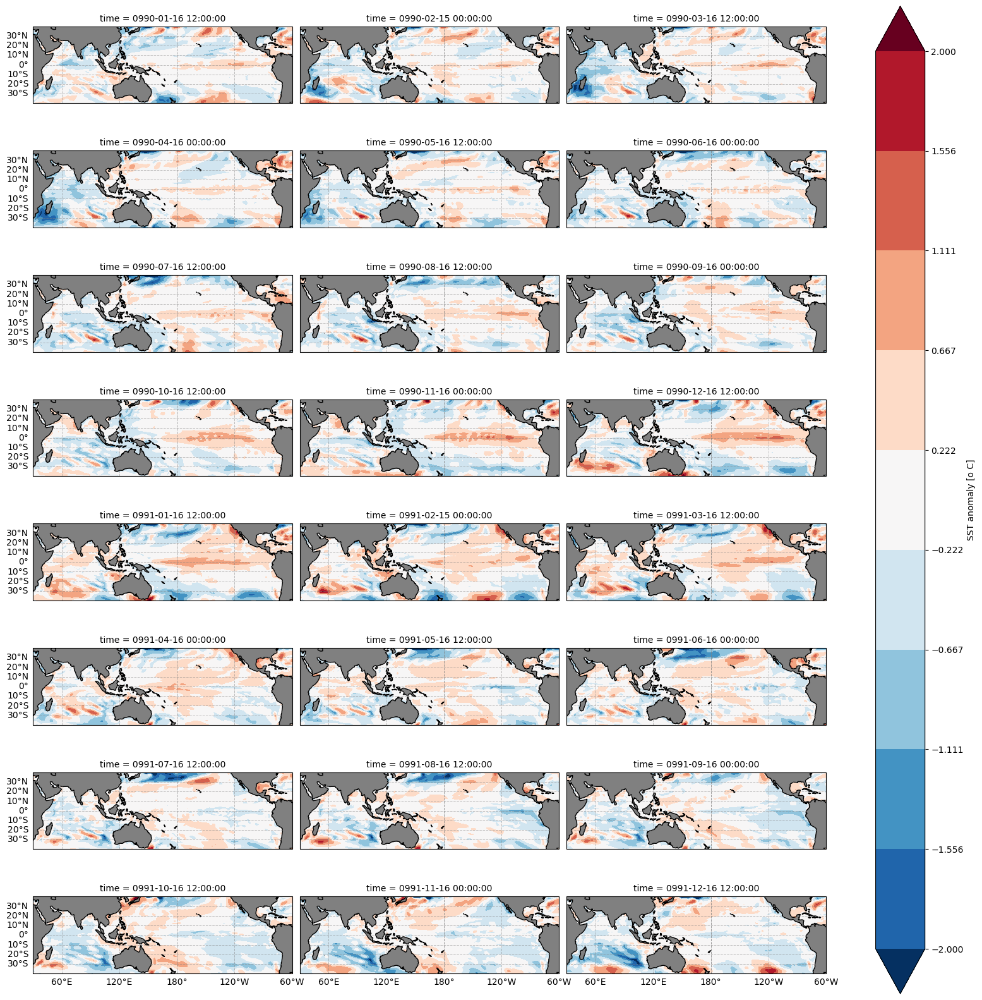

In [17]:
lat_limits = (-40, 40)
lon_limits = (-150, 120) 
fg = cp_hssta01.plot.contourf(col="time", col_wrap = 3, transform=ccrs.PlateCarree(),
                subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180), "xlim": lon_limits, "ylim": lat_limits},
                          figsize=(16,16), vmin = -2, levels =10, extend = 'both',  cmap = 'RdBu_r',
                            cbar_kwargs=dict(label='SST anomaly [o C]'))
for i, ax in enumerate(fg.axs.flat):
    ax.coastlines()
    ax.set_facecolor('grey')
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')

    if i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20]:
        gl.bottom_labels = False
    if i in [1,2,4,5,7,8,10,11,13,14,16,17,19,20,22,23]:
        gl.left_labels = False
    gl.top_labels = False
    gl.right_labels = False  

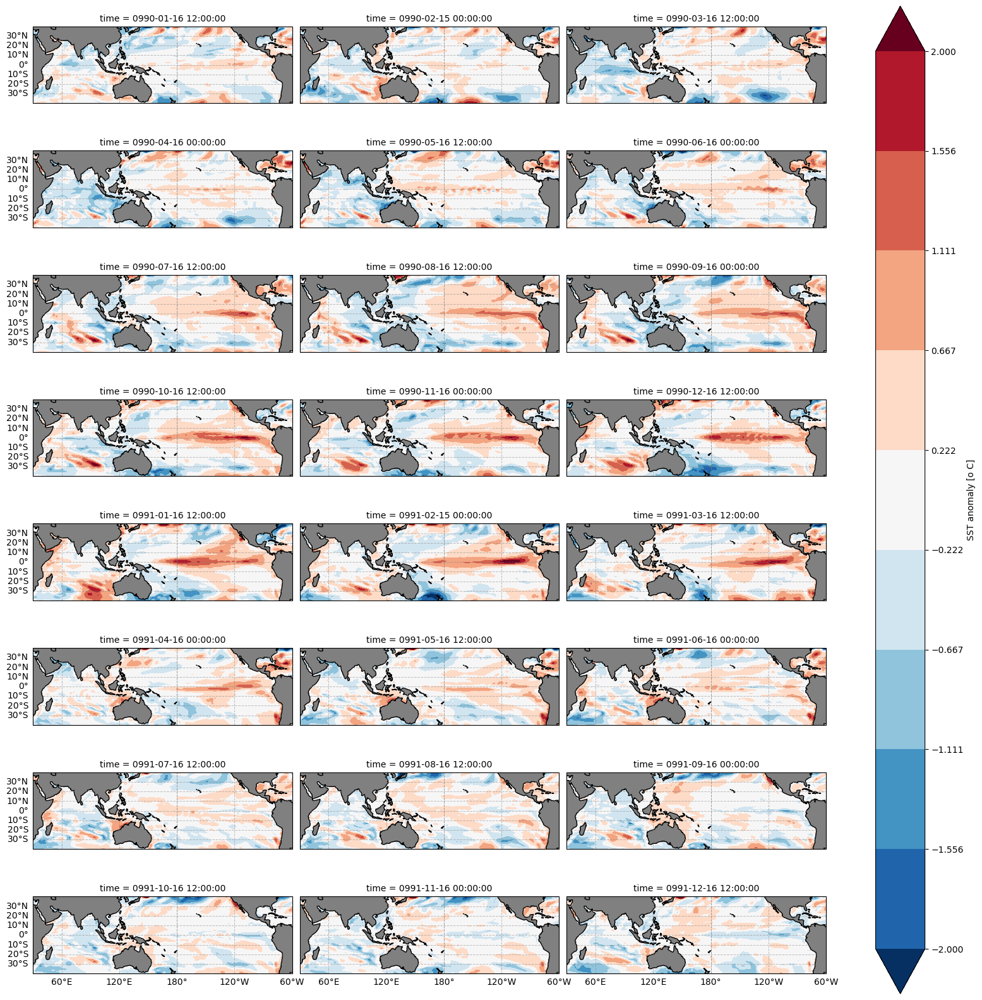

In [18]:
lat_limits = (-40, 40)
lon_limits = (-150, 120) 
fg = cp_mssta01.plot.contourf(col="time", col_wrap = 3, transform=ccrs.PlateCarree(),
                subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180), "xlim": lon_limits, "ylim": lat_limits},
                          figsize=(16,16), vmin = -2, levels =10, extend = 'both',  cmap = 'RdBu_r',
                            cbar_kwargs=dict(label='SST anomaly [o C]'))
for i, ax in enumerate(fg.axs.flat):
    ax.coastlines()
    ax.set_facecolor('grey')
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')

    if i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20]:
        gl.bottom_labels = False
    if i in [1,2,4,5,7,8,10,11,13,14,16,17,19,20,22,23]:
        gl.left_labels = False
    gl.top_labels = False
    gl.right_labels = False  

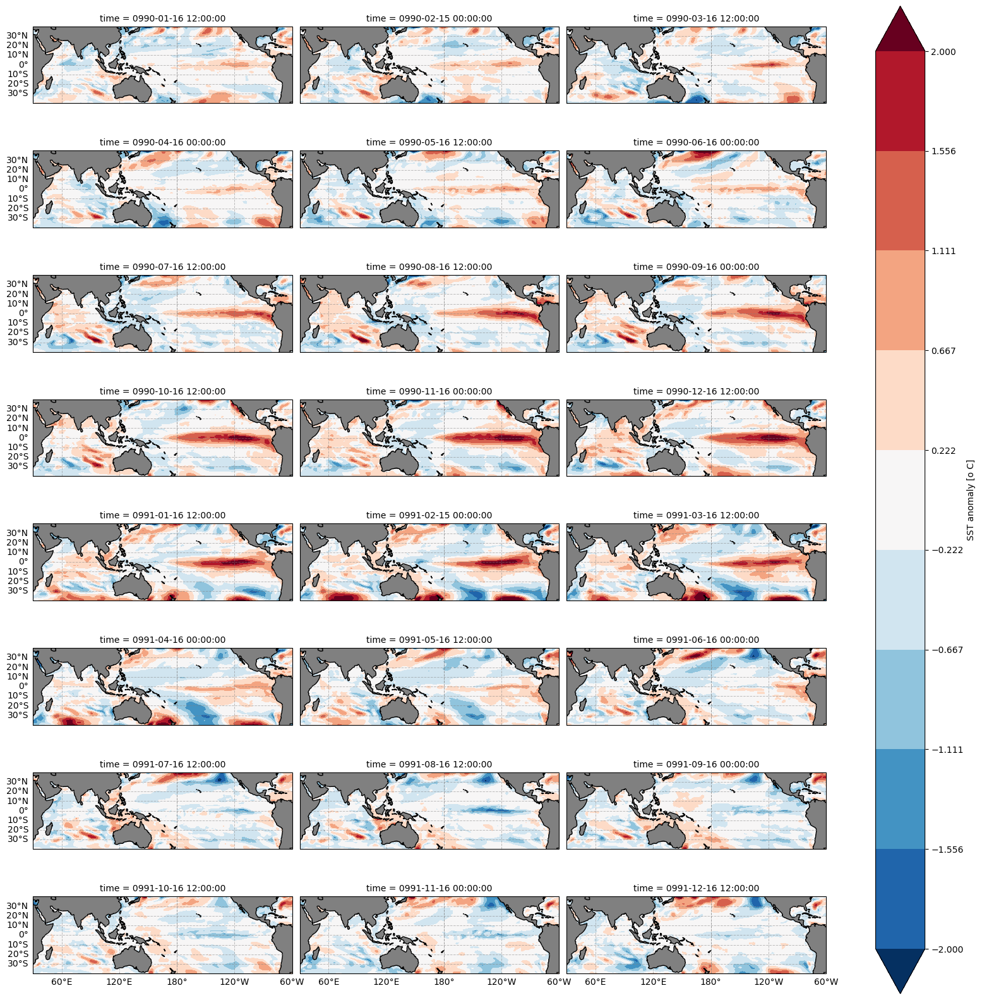

In [19]:
lat_limits = (-40, 40)
lon_limits = (-150, 120) 
fg = ep_hssta01.plot.contourf(col="time", col_wrap = 3, transform=ccrs.PlateCarree(),
                subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180), "xlim": lon_limits, "ylim": lat_limits},
                          figsize=(16,16), vmin = -2, levels =10, extend = 'both',  cmap = 'RdBu_r',
                            cbar_kwargs=dict(label='SST anomaly [o C]'))
for i, ax in enumerate(fg.axs.flat):
    ax.coastlines()
    ax.set_facecolor('grey')
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')

    if i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20]:
        gl.bottom_labels = False
    if i in [1,2,4,5,7,8,10,11,13,14,16,17,19,20,22,23]:
        gl.left_labels = False
    gl.top_labels = False
    gl.right_labels = False  

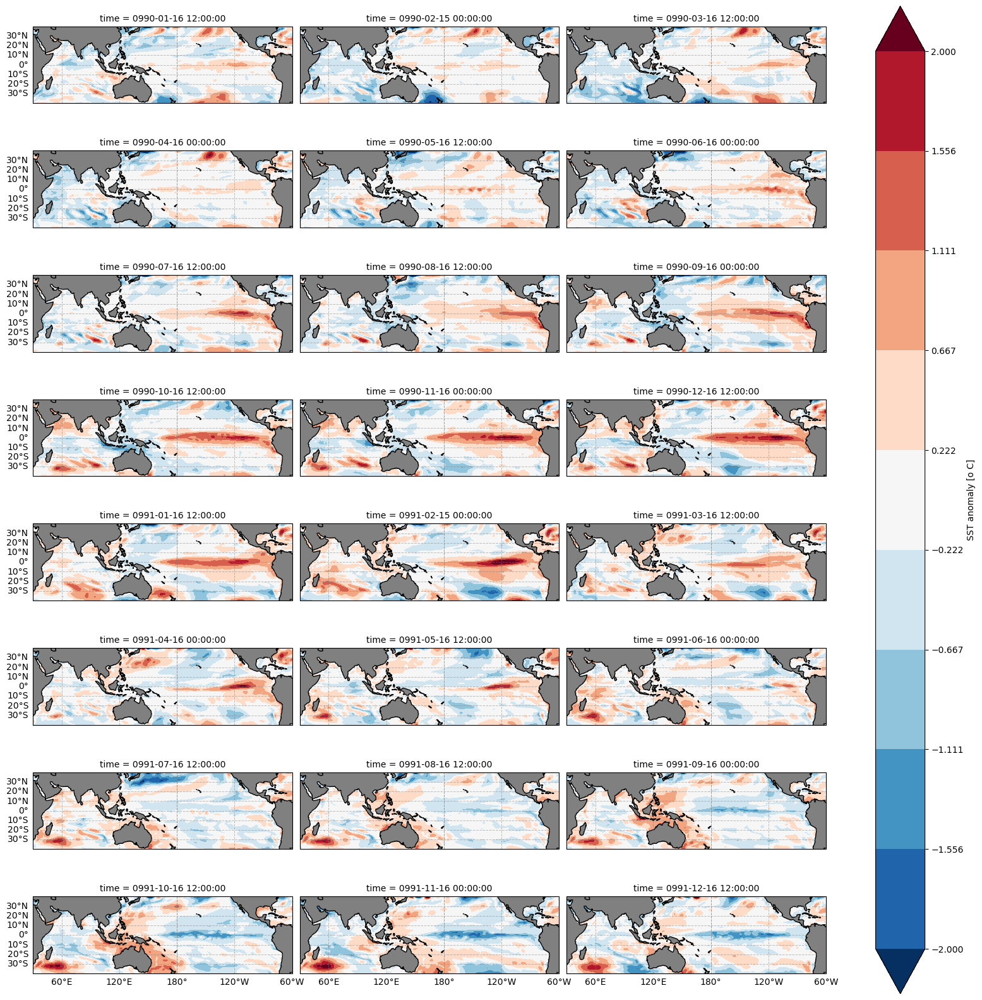

In [20]:
lat_limits = (-40, 40)
lon_limits = (-150, 120) 
fg = ep_mssta01.plot.contourf(col="time", col_wrap = 3, transform=ccrs.PlateCarree(),
                subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180), "xlim": lon_limits, "ylim": lat_limits},
                          figsize=(16,16), vmin = -2, levels =10, extend = 'both',  cmap = 'RdBu_r',
                            cbar_kwargs=dict(label='SST anomaly [o C]'))
for i, ax in enumerate(fg.axs.flat):
    ax.coastlines()
    ax.set_facecolor('grey')
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')

    if i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20]:
        gl.bottom_labels = False
    if i in [1,2,4,5,7,8,10,11,13,14,16,17,19,20,22,23]:
        gl.left_labels = False
    gl.top_labels = False
    gl.right_labels = False  

In [40]:
cp_had = xr.open_dataset("/g/data/e14/sm2435/Pacemaker/ocean_month.nc-09901231",  use_cftime=True, chunks= {"time":12})

In [41]:
cp_had1 = xr.open_dataset("/g/data/e14/sm2435/Pacemaker/ocean_month.nc-09911231",  use_cftime=True, chunks= {"time":12})

In [44]:
cp_sst = cp_had.sst.compute()
cp_sst1 = cp_had1.sst.compute()
cp_sst01 = cp_had01.sst.compute()

In [45]:
cp_sst = roll_lon(cp_sst)
cp_sst1 = roll_lon(cp_sst1)
cp_sst01 = roll_lon(cp_sst01)

In [46]:
cp_ssta = cp_sst.groupby("time.month") - ctrl.groupby("time.month").mean("time")
cp_ssta1 = cp_sst1.groupby("time.month") - ctrl.groupby("time.month").mean("time")
cp_ssta01 = cp_sst01.groupby("time.month") - ctrl.groupby("time.month").mean("time")

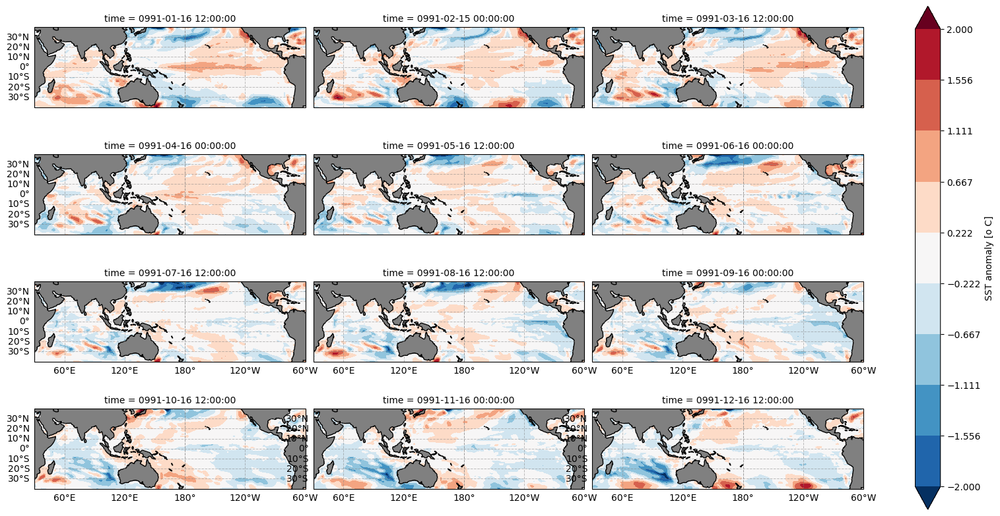

In [22]:
lat_limits = (-40, 40)
lon_limits = (-150, 120) 
fg = cp_ssta1.plot.contourf(col="time", col_wrap = 3, transform=ccrs.PlateCarree(),
                subplot_kws={"projection": ccrs.PlateCarree(central_longitude = 180), "xlim": lon_limits, "ylim": lat_limits},
                          figsize=(16,8), vmin = -2, levels =10, extend = 'both',  cmap = 'RdBu_r',
                            cbar_kwargs=dict(label='SST anomaly [o C]'))
for i, ax in enumerate(fg.axs.flat):
    ax.coastlines()
    ax.set_facecolor('grey')
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=0.7, color='gray', alpha=0.5, linestyle='--')

    if i in [0,1,2,3,4,5]:
        gl.bottom_labels = False
    if i in [1,2,4,5,7,8]:
        gl.left_labels = False
    gl.top_labels = False
    gl.right_labels = False  

In [21]:
def ssta(DS):
    clim = DS.groupby('time.month').mean('time')
    ssta = DS.groupby('time.month') - clim
    return ssta.drop("month")
def DMI_ctrl(DS):
    WTIO =  ssta(DS).sel(yt_ocean=slice(
         -10, 10),xt_ocean=slice(50, 70)).mean(['yt_ocean', 'xt_ocean'])
    SETIO =  ssta(DS).sel(yt_ocean=slice(
         -10, 0),xt_ocean=slice(90, 110)).mean(['yt_ocean', 'xt_ocean'])
    return (WTIO - SETIO)

def DMI_exp(DS):
    WTIO =  (DS).sel(yt_ocean=slice(
         -10, 10),xt_ocean=slice(50, 70)).mean(['yt_ocean', 'xt_ocean'])
    SETIO =  (DS).sel(yt_ocean=slice(
         -10, 0),xt_ocean=slice(90, 110)).mean(['yt_ocean', 'xt_ocean'])
    return (WTIO - SETIO)

In [22]:
ctrl_dmi_std = DMI_ctrl(ctrl).groupby("time.month").std("time")

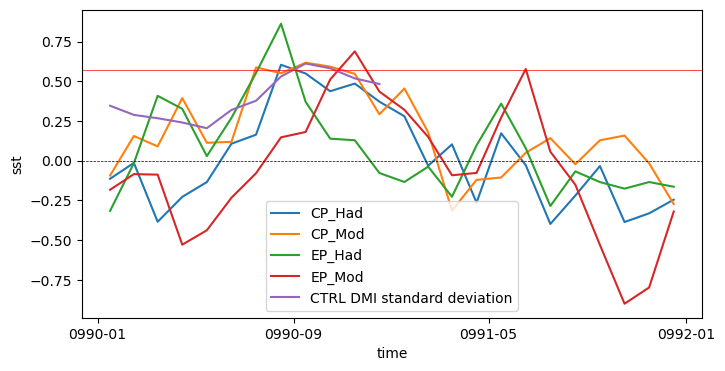

In [27]:
plt.figure(figsize = (8,4))
DMI_exp(cp_hssta01).plot(label = "CP_Had")
DMI_exp(cp_mssta01).plot(label = "CP_Mod")
DMI_exp(ep_hssta01).plot(label = "EP_Had")
DMI_exp(ep_mssta01).plot(label = "EP_Mod")
ctrl_dmi_std.rename({"month": "time"}).assign_coords({"time": cp_hssta01.time[0:12]}).plot(label = "CTRL DMI standard deviation")
#DMI_exp(ctrl990).plot(label = "CTRL restart year")
plt.axhline(DMI_ctrl(ctrl).groupby("time.season")["SON"].std("time").values, lw = 0.5, color = 'r')
plt.axhline(0, lw = 0.5, ls = "--", color = 'k')
plt.legend()

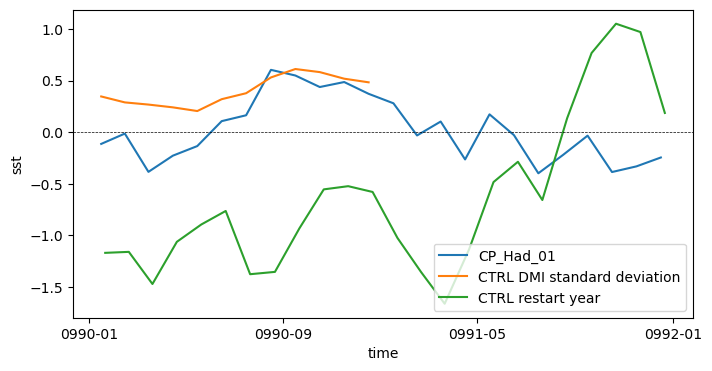

In [59]:
plt.figure(figsize = (8,4))
DMI_exp(cp_ssta01).plot(label = "CP_Had_01")
ctrl_dmi_std.rename({"month": "time"}).assign_coords({"time": cp_sst.time}).plot(label = "CTRL DMI standard deviation")
DMI_exp(ctrl990).plot(label = "CTRL restart year")
plt.axhline(0, lw = 0.5, ls = "--", color = 'k')
plt.legend()

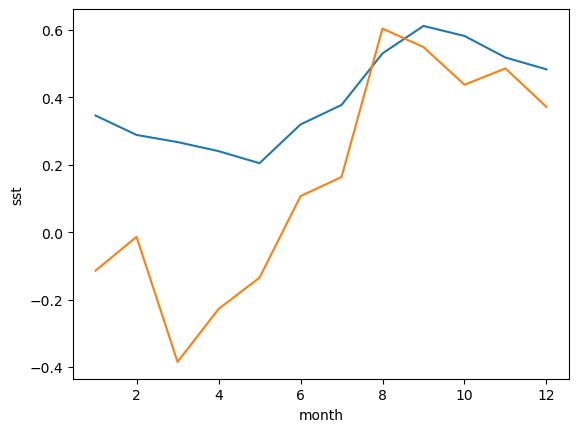

In [41]:
DMI_ctrl(ctrl).groupby("time.month").std("time").plot()
DMI_exp(cp_ssta).groupby("time.month").mean("time").plot()

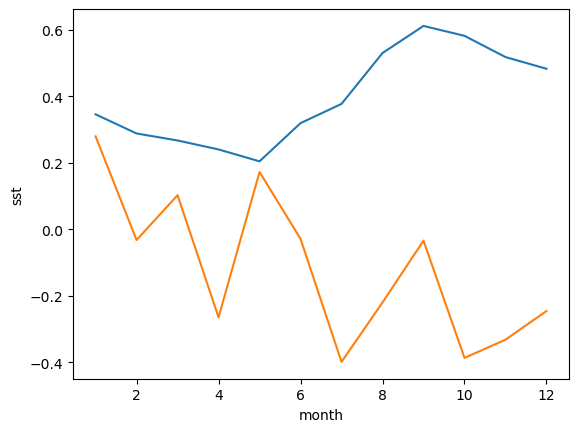

In [24]:
DMI_ctrl(ctrl).groupby("time.month").std("time").plot()
DMI_exp(cp_ssta1).groupby("time.month").mean("time").plot()

In [57]:
ctrl990 = ctrl.sel(time = slice("0990-01-01", "0991-12-31"))

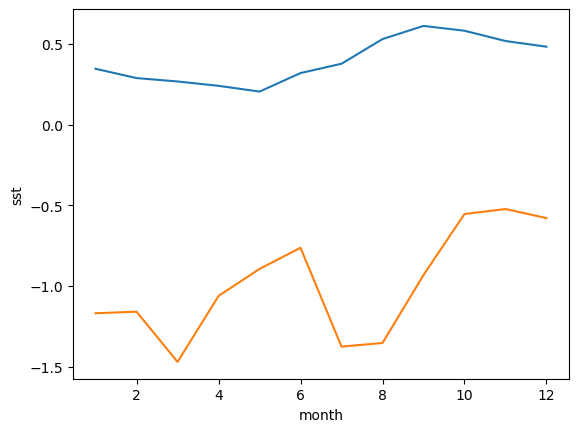

In [28]:
DMI_ctrl(ctrl).groupby("time.month").std("time").plot()
DMI_exp(ctrl990).groupby("time.month").mean("time").plot()
